# EPI Analysis Code Part 2:
1) Choose day
2) Read in radar data and filter (remove speckles and melting layer)
3) For each flight leg on that day:
    3) Reads in HRRR Cross section
    5) Identifies all EPI layers
    6) Filters EPI Layers (removes multiple layers within 1 layer, removes all layers below a set height)
    7) Identifies when P3 is within a layer of EPI
    8) Creates a dataframe
9) Save dataframe of all EPI layers for all flight legs for given day

In [1]:
import fsspec
import h5py
import xarray as xr

import netCDF4
from netCDF4 import Dataset

import metpy.calc as mpcalc
from metpy.interpolate import cross_section, interpolate_to_slice
from metpy.units import units
from metpy.plots import USCOUNTIES

import cartopy.crs as ccrs
import cartopy.feature as cfeature

import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
import matplotlib.gridspec as gridspec
import matplotlib.dates as mdates

import numpy as np
import pandas as pd

import scipy
from scipy.ndimage import gaussian_filter, gaussian_filter1d

import icartt

import glob

import math as mt

from datetime import datetime, timedelta

import warnings
warnings.filterwarnings("ignore")

# Define Paramters:
- day: choosen IOP ['YYYYMMDD']
- yr: specify year of IOP [YYYY]
- Region: region to map over ['MW' (midwest)  or 'NE' (northeast)]
- ymin/ymax: top and bottom boundaries for vertical cross sections
- fl_choice: aircraft you want to interpoate HRRR to ['P3' or 'ER2']
- EPI_type: equivalent potential temperature wrt ice or water to be used for unstable layers ['thetaei' or 'thetae']
- path: file path for where your data is

In [73]:
day='20200125'
yr=2020

region='NE'

ymin=0
ymax=12

fl_choice='ER2'
EPI_type='thetae'

#fcst_lead = 0 # number of hours 

path=''

# Defining Functions

## Setting Variable Definitions

In [3]:
if region=='NE':
    lats=33
    latn=48
    lonw=360-82
    lone=360-68
    
if region=='MW':
    lats=39
    latn=47
    lonw=360-96
    lone=360-84

plotcrs = ccrs.LambertConformal(central_latitude=lats+((latn-lats)/2), central_longitude=lone-((276-264)/2))

In [4]:
if day=='jan182020':
    startT_p3='2020-01-18 18:02:00'
    endT_p3='2020-01-19 00:02:00'
    
    startT_er2='2020-01-18 17:15:00'
    endT_er2='2020-01-18 21:06:00'
    
    date='2020-01-18'
    
    title=str('January 18, 2020')
    
if day=='jan252020':
    startT_er2='2020-01-25 17:49:00'
    endT_er2='2020-01-26 01:25:00'
    
    date='2020-01-25'
    
if day=='feb012020':
    startT_er2='2020-02-01 11:09:00'
    endT_er2='2020-02-01 17:07:00'
    
    date='2020-02-01'
    
if day=='feb052020':
    startT_er2='2020-02-05 18:59:00'
    endT_er2='2020-02-06 01:34:00'
    
    date='2020-02-05'
    
if day=='feb072020':
    startT_er2='2020-02-071, 12:04:00'
    endT_er2='2020-02-07 18:51:00'
    
    date='2020-02-07'

if day=='feb252020':
    startT_er2='2020-02-25 20:06:00'
    endT_er2='2020-02-26 03:56:00'
    
    date='2020-02-25'
    
if day=='feb272020':
    startT_er2='2020-02-27 07:21:00'
    endT_er2='2020-02-27 15:16:00'
    
    date='2020-02-27'

if day=='jan192022':
    startT_er2='2022-01-19 10:46:00'
    endT_er2='2022-01-19 17:57:00'
    
    date='2022-01-19'
    
if day=='jan292022':
    startT_er2='2022-01-29 22:17:00'
    endT_er2='2022-01-30 03:47:00'
    
    date='2022-01-29'
    
if day=='feb032022':
    startT_er2='2022-02-03 13:53:00'
    endT_er2='2022-02-03 17:05:00'
    
    date='2022-02-03'
    
if day=='feb042022':
    startT_er2='2022-02-04 12:29:00'
    endT_er2='2022-02-04 20:30:00'
    
    date='2022-02-04'
    
if day=='feb082022':
    startT_er2='2022-02-08 11:59:00'
    endT_er2='2022-02-08 19:17:00'
    
    date='2022-02-08'
    
if day=='feb132022':
    startT_er2='2022-02-13 11:29:00'
    endT_er2='2022-02-13 16:24:00'
    
    date='2022-02-13'
    
if day=='feb172022':
    startT_er2='2022-02-17 16:07:00'
    endT_er2='2022-02-17 00:27:00'
    
    date='2022-02-17'

if day=='feb192022':
    startT_p3='2022-02-19 12:12:00'
    endT_p3='2022-02-19 19:18:00'
    
    startT_er2='2022-02-19 12:07:00'
    endT_er2='2022-02-19 17:30:00'
    
    date='2022-02-19'
    
if day=='feb252022':
    startT_er2='2022-02-25 07:58:00'
    endT_er2='2022-02-25 15:34:00'
    
    date='2022-02-25'
    
if day=='jan132023':
    startT_er2='2023-01-13 03:55:00'
    endT_er2='2023-01-13 11:22:00'
    
    date='2023-01-13'
    
if day=='jan152023':
    startT_er2='2023-01-15 13:09:00'
    endT_er2='2023-01-15 20:26:00'
    
    date='2023-01-15'
    
if day=='jan192023':
    startT_er2='2023-01-19 19:58:00'
    endT_er2='2023-01-20 03:47:00'
    
    date='2023-01-19'
    
if day=='jan232023':
    startT_er2='2023-01-23 12:21:00'
    endT_er2='2023-01-23 19:42:00'
    
    date='2023-01-23'
    
if day=='jan252023':
    startT_er2='2023-01-25 17:52:00'
    endT_er2='2023-01-26 01:56:00'
    
    date='2023-01-25'
    
if day=='jan292023':
    startT_er2='2023-01-29 12:57:00'
    endT_er2='2023-01-29 19:02:00'
    
    date='2023-01-29'
    
if day=='feb052023':
    startT_er2='2023-02-05 13:00:00'
    endT_er2='2023-02-05 20:41:00'
    
    date='2023-02-05'

if day=='feb122023':
    startT_er2='2023-02-12 13:07:00'
    endT_er2='2023-02-12 20:16:00'
    
    date='2023-02-12'
    
if day=='feb142023':
    startT_er2='2023-02-14 21:57:00'
    endT_er2='2023-02-15 05:27:00'
    
    date='2023-02-14'
    
if day=='feb172023':
    startT_er2='2023-02-17 12:13:00'
    endT_er2='2023-02-17 20:01:00'
    
    date='2023-02-17'
    
if day=='feb282023':
    startT_er2='2023-02-28 09:00:00'
    endT_er2='2023-02-28 16:37:00'
    
    date='2023-02-28'

In [5]:
def fldef(day):
    if day=='20200125':
        lowtype='MB'
        #ER2: FL start... 20:00:08, end... 23:00:00
        er2_flight_legs=[#['2020-01-25 19:17:00', '2020-01-25 19:31:07', '0'], #not actual FL
                        #['2020-01-25 19:33:00', '2020-01-25 19:56:43', '0'], 
                        ['2020-01-25 20:00:08', '2020-01-25 20:16:23', '1'],
                        ['2020-01-25 20:18:30', '2020-01-25 20:25:48', '2'],
                        ['2020-01-25 20:29:18', '2020-01-25 20:51:29', '3'],
                        ['2020-01-25 20:54:40', '2020-01-25 21:02:14', '4'],
                        ['2020-01-25 21:04:20', '2020-01-25 21:21:10', '5'],
                        ['2020-01-25 21:23:12', '2020-01-25 21:30:29', '6'],
                        ['2020-01-25 21:33:56', '2020-01-25 21:56:18', '7'],
                        ['2020-01-25 22:00:18', '2020-01-25 22:08:02', '8'],
                        ['2020-01-25 22:13:38', '2020-01-25 22:33:25', '9'],
                        ['2020-01-25 22:37:00', '2020-01-25 22:43:00', '10'],
                        ['2020-01-25 22:45:00', '2020-01-25 23:00:00', '11']]#,
                        #['2020-01-25 23:01:30', '2020-01-25 23:07:26', '0']] #not actual FL?
        p3_synfl      = [
                        ['2020-01-25 21:02:05', '2020-01-25 21:21:06', '5']]
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevB_20200125.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'

    if day=='20200201':
        lowtype='MA'
        #ER2: FL start... 12:22:43, end... 14:08:41
        er2_flight_legs=[['2020-02-01 12:22:43', '2020-02-01 12:38:21', '1'],
                        ['2020-02-01 12:42:53', '2020-02-01 13:00:51', '2'],
                        ['2020-02-01 13:06:00', '2020-02-01 13:20:33', '3'],
                        ['2020-02-01 13:25:10', '2020-02-01 13:42:04', '4'],
                        ['2020-02-01 13:52:48', '2020-02-01 14:08:41', '5']]#,
                        #['2020-02-01 14:28:00', '2020-02-01 14:49:24', '0'],
                        #['2020-02-01 14:50:52', '2020-02-01 14:57:30', '0'],
                        #['2020-02-01 14:58:00', '2020-02-01 15:23:56', '0']]
        p3_synfl      = []
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevB_20200201.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'

    if day=='20200205':
        lowtype='AF'
        er2_flight_legs=[['2020-02-05 20:58:00', '2020-02-05 21:31:00', '1'],
                        ['2020-02-05 21:40:30', '2020-02-05 22:16:00', '2'],
                        ['2020-02-05 22:31:30', '2020-02-05 22:59:00', '3']]
                        #['2020-02-05 23:07:30', '2020-02-05 23:14:50', '4'],
                        #['2020-02-05 23:16:00', '2020-02-05 23:24:00', '5'], #diagonal
                        #['2020-02-05 23:29:00', '2020-02-05 23:37:00', '6'], #diagonal
                        #['2020-02-05 23:47:52', '2020-02-06 00:05:00', '7']] #RTB
        p3_synfl      = []
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevB_20200205.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'

    if day=='20200207':
        lowtype='MA'
        #ER2: FL start... 13:55:01, end... 16:13:18
        er2_flight_legs=[#['2020-02-07 13:22:00', '2020-02-07 13:52:48', '0'],
                       ['2020-02-07 13:55:01', '2020-02-07 14:29:04', '1'],
                       ['2020-02-07 14:33:00', '2020-02-07 14:52:54', '2'],
                       ['2020-02-07 14:56:27', '2020-02-07 15:04:54', '3'],
                       ['2020-02-07 15:08:20', '2020-02-07 15:24:08', '4'], 
                       ['2020-02-07 15:27:37', '2020-02-07 15:50:36', '5'],
                       ['2020-02-07 15:54:50', '2020-02-07 16:13:18', '6']]#,
                       #['2020-02-07 16:17:55', '2020-02-07 17:00:00', '0']]
        p3_synfl      = []
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevB_20200207.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'

    if day=='20200225':
        lowtype='GPC'
        #ER2: FL start... 21:45:27, end... 01:42:04
        er2_flight_legs=[['2020-02-25 21:45:27', '2020-02-25 22:02:41', '1'],
                        ['2020-02-25 22:08:34', '2020-02-25 22:25:20', '2'], 
                        ['2020-02-25 22:28:28', '2020-02-25 22:48:16', '3'],
                        ['2020-02-25 22:52:57', '2020-02-25 23:12:54', '4'],
                        ['2020-02-25 23:18:24', '2020-02-25 23:29:00', '5'], #FL 5 and 6 are in same track but are split by a spiral
                        ['2020-02-25 23:36:00', '2020-02-25 23:43:07', '6'],
                        ['2020-02-25 23:46:00', '2020-02-26 00:05:05', '7'],
                        ['2020-02-26 00:10:35', '2020-02-26 00:20:22', '8'], 
                        ['2020-02-26 00:27:30', '2020-02-26 00:42:50', '9'], 
                        ['2020-02-26 00:50:00', '2020-02-26 01:03:44', '10'],
                        ['2020-02-26 01:07:42', '2020-02-26 01:23:26', '11'], 
                        ['2020-02-26 01:27:00', '2020-02-26 01:42:04', '12']]#, 
                        #['2020-02-26 01:45:33', '2020-02-26 01:55:00', '0']]
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_RevB_20200225.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'

    if day=='20200227':
        lowtype='MB'
        #ER2: FL start... 09:15:20, end... 13:04:00
        er2_flight_legs=[#['2020-02-27 08:23:00', '2020-02-27 08:30:19', '0'],
                        #['2020-02-27 08:30:55', '2020-02-27 08:55:31', '0'],
                        #['2020-02-27 08:57:09', '2020-02-27 09:14:45', '0'],
                        ['2020-02-27 09:15:20', '2020-02-27 09:45:52', '1'],
                        ['2020-02-27 09:49:03', '2020-02-27 10:16:37', '2'],
                        ['2020-02-27 10:20:23', '2020-02-27 10:49:46', '3'],
                        ['2020-02-27 10:53:06', '2020-02-27 11:20:39', '4'],
                        ['2020-02-27 11:24:05', '2020-02-27 11:45:41', '5'],
                        ['2020-02-27 11:49:05', '2020-02-27 12:09:31', '6'],
                        ['2020-02-27 12:12:42', '2020-02-27 12:27:05', '7'],
                        ['2020-02-27 12:32:26', '2020-02-27 12:45:45', '8'],
                        ['2020-02-27 12:49:49', '2020-02-27 13:04:00', '9']]
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_RevB_20200227.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2020_HIWRAP_L1B_RevD_'+day+'.h5'

    if day=='20220119':
        lowtype='AC'
        #ER2: FL start... 12:30:00, end... 15:45:13
        er2_flight_legs=[#['2022-01-19 11:50:07', '2022-01-19 12:28:00', '0'],
                        ['2022-01-19 12:30:00', '2022-01-19 12:50:00', '1'],
                        ['2022-01-19 12:58:00', '2022-01-19 13:09:38', '2'],
                        ['2022-01-19 13:16:00', '2022-01-19 13:24:00', '3'],
                        ['2022-01-19 13:37:38', '2022-01-19 13:57:33', '4'],
                        ['2022-01-19 14:07:00', '2022-01-19 14:16:53', '5'],
                        ['2022-01-19 14:24:00', '2022-01-19 14:30:43', '6'],
                        ['2022-01-19 14:44:38', '2022-01-19 14:52:38', '7'],
                        ['2022-01-19 15:00:00', '2022-01-19 15:10:00', '8'],
                        ['2022-01-19 15:17:18', '2022-01-19 15:29:03', '9'],
                        ['2022-01-19 15:35:30', '2022-01-19 15:45:13', '10']]#,
                       #['2022-01-19 15:48:00', '2022-01-19 16:29:28', '0']]
        p3_synfl      = []
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevA_20220119.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2022_HIWRAP_KA_L1B_RevB_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2022_HIWRAP_KU_L1B_RevB_'+day+'.h5'

    if day=='20220129':
        lowtype='MA'
        #ER2: FL start... 23:59:56, end... 01:56:16
        er2_flight_legs=[#['2022-01-29 23:20:00', '2022-01-29 23:57:01', '0'],
                        ['2022-01-29 23:59:56', '2022-01-30 00:08:46', '1'],
                        ['2022-01-30 00:16:00', '2022-01-30 00:23:00', '2'],
                        ['2022-01-30 00:32:56', '2022-01-30 00:38:51', '3'],
                        ['2022-01-30 00:44:30', '2022-01-30 00:48:00', '4'],
                        ['2022-01-30 00:53:51', '2022-01-30 01:03:00', '5'],
                        ['2022-01-30 01:08:30', '2022-01-30 01:11:00', '6'],
                        ['2022-01-30 01:14:36', '2022-01-30 01:23:00', '7'],
                        ['2022-01-30 01:31:30', '2022-01-30 01:56:16', '8']]#,
                        #['2022-01-30 01:58:00', '2022-01-30 02:10:00', '0']]
        p3_synfl      = []
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevA_20220129.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2022_HIWRAP_KA_L1B_RevB_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2022_HIWRAP_KU_L1B_RevB_'+day+'.h5'

    if day=='20220203':
        lowtype='AF'
        er2_flight_legs=[#['2022-02-03 14:00:00', '2022-02-03 14:40:00', '1'], #going out
                        ['2022-02-03 14:42:30', '2022-02-03 15:17:00', '1'],
                        ['2022-02-03 15:28:00', '2022-02-03 16:04:00', '2']]
                        #['2022-02-03 16:06:00', '2022-02-03 16:32:00', '4']] #RTB
        p3_synfl      = []
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevA_20220203.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2022_HIWRAP_KA_L1B_RevB_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2022_HIWRAP_KU_L1B_RevB_'+day+'.h5'

    if day=='20220204':
        lowtype='AF'
        er2_flight_legs=[#['2022-02-04 12:55:00', '2022-02-04 13:35:00', '1'], #going out
                        ['2022-02-04 13:43:30', '2022-02-04 14:12:00', '1'],
                        ['2022-02-04 14:41:00', '2022-02-04 15:10:30', '2'],
                        ['2022-02-04 15:21:00', '2022-02-04 15:52:00', '3'],
                        ['2022-02-04 16:04:00', '2022-02-04 16:44:30', '4'],
                        ['2022-02-04 16:50:00', '2022-02-04 17:28:00', '5'],
                        ['2022-02-04 17:37:00', '2022-02-04 18:14:00', '6']]
                        #['2022-02-04 18:21:30', '2022-02-04 19:12:00', '8'], #RTB pt 1
                        #['2022-02-04 19:13:00', '2022-02-04 19:56:00', '9']] #RTB pt 2
        p3_synfl      = []
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevA_20220204.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2022_HIWRAP_KA_L1B_RevB_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2022_HIWRAP_KU_L1B_RevB_'+day+'.h5'

    if day=='20220208':
        lowtype='MA'
        #ER2 FL: start... 14:27:48, end... 16:48:40
        er2_flight_legs=[#['2022-02-08 12:28:00', '2022-02-08 12:49:30', '0'],
                        #['2022-02-08 12:51:00', '2022-02-08 14:02:30', '0'],
                        ['2022-02-08 14:27:48', '2022-02-08 14:47:00', '1'],
                        ['2022-02-08 14:48:00', '2022-02-08 15:08:00', '2'],
                        ['2022-02-08 15:10:38', '2022-02-08 15:26:30', '3'],
                        ['2022-02-08 15:30:00', '2022-02-08 15:37:30', '4'],
                        ['2022-02-08 15:42:30', '2022-02-08 16:11:00', '5'],
                        ['2022-02-08 16:21:13', '2022-02-08 16:48:40', '6']]#,
                        #['2022-02-08 16:52:30', '2022-02-08 17:30:00', '0']]
        p3_synfl      = []
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevA_20220208.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2022_HIWRAP_KA_L1B_RevB_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2022_HIWRAP_KU_L1B_RevB_'+day+'.h5'

    if day=='20220213':
        lowtype='AF'
        er2_flight_legs=[#['2022-02-13 12:10:00', '2022-02-13 12:55:00', '1'], #going out
                        #['2022-02-13 12:56:30', '2022-02-13 13:03:00', '2'],
                        #['2022-02-13 13:15:50', '2022-02-13 13:31:00', '3'],
                        #['2022-02-13 13:32:00', '2022-02-13 13:41:00', '4'],
                        ['2022-02-13 13:44:00', '2022-02-13 14:02:00', '1'],
                        ['2022-02-13 14:09:30', '2022-02-13 14:20:55', '2'],
                        ['2022-02-13 14:29:40', '2022-02-13 14:38:30', '3']]
                        #['2022-02-13 14:44:00', '2022-02-13 15:23:00', '8']] #RTB
        p3_synfl      = []
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevA_20220213.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2022_HIWRAP_KA_L1B_RevB_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2022_HIWRAP_KU_L1B_RevB_'+day+'.h5'

    if day=='20220217':
        lowtype='AF'
        er2_flight_legs=[#['2022-02-17 16:50:00', '2022-02-17 17:32:00', '1'], #going out
                        ['2022-02-17 17:35:00', '2022-02-17 17:56:30', '1'],
                        ['2022-02-17 18:03:00', '2022-02-17 18:23:00', '2'],
                        #['2022-02-17 18:27:30', '2022-02-17 18:32:30', '4'],
                        #['2022-02-17 18:35:50', '2022-02-17 18:40:00', '5'],
                        #['2022-02-17 18:44:10', '2022-02-17 18:49:30', '6'],
                        #['2022-02-17 18:51:10', '2022-02-17 18:53:00', '7'],
                        #['2022-02-17 18:54:30', '2022-02-17 18:58:00', '8'],
                        ['2022-02-17 19:04:00', '2022-02-17 19:29:00', '3'],
                        ['2022-02-17 19:44:10', '2022-02-17 19:57:30', '4'],
                        ['2022-02-17 20:12:00', '2022-02-17 20:34:00', '5'],
                        ['2022-02-17 20:43:30', '2022-02-17 21:02:00', '6'],
                        ['2022-02-17 21:13:30', '2022-02-17 21:34:00', '7'],
                        ['2022-02-17 21:40:30', '2022-02-17 21:59:00', '8'],
                        ['2022-02-17 22:12:00', '2022-02-17 22:32:00', '9']]
                        #['2022-02-17 22:39:00', '2022-02-17 23:32:00', '16']] #RTB
        
        p3_synfl      = [['2022-02-17 19:03:15', '2022-02-17 19:25:50', '3']]
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevA_20220217.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2022_HIWRAP_KA_L1B_RevB_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2022_HIWRAP_KU_L1B_RevB_'+day+'.h5'

    if day=='20220225':
        lowtype='MB'
        #ER2 FL: start... 09:18:00, end... 13:24:30
        er2_flight_legs=[#['2022-02-25 08:50:00', '2022-02-25 08:59:00', '0'],
                        #['2022-02-25 09:01:00', '2022-02-25 09:07:00', '0'],
                        #['2022-02-25 09:09:00', '2022-02-25 09:17:00', '0'],
                        ['2022-02-25 09:18:00', '2022-02-25 09:34:00', '1'],
                        ['2022-02-25 09:42:00', '2022-02-25 09:59:30', '2'],
                        ['2022-02-25 10:06:30', '2022-02-25 10:25:00', '3'],
                        ['2022-02-25 10:33:30', '2022-02-25 10:51:00', '4'],
                        ['2022-02-25 11:00:30', '2022-02-25 11:16:20', '5'],
                        ['2022-02-25 11:24:30', '2022-02-25 11:42:30', '6'],
                        ['2022-02-25 11:52:00', '2022-02-25 12:08:00', '7'],
                        ['2022-02-25 12:16:30', '2022-02-25 12:33:00', '8'],
                        ['2022-02-25 12:41:00', '2022-02-25 12:58:50', '9'],
                        ['2022-02-25 13:08:14', '2022-02-25 13:24:30', '10']]#,
                        #['2022-02-25 13:26:00', '2022-02-25 14:05:00', '0']]
        p3_synfl      = []
        
        wfile= path+'CRS/IMPACTS_CRS_L1B_RevA_20220225.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2022_HIWRAP_KA_L1B_RevB_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2022_HIWRAP_KU_L1B_RevB_'+day+'.h5'
    
    if day=='20230113':
        lowtype='GPC'
        er2_flight_legs=[#['2023-01-13 04:24:56', '2023-01-13 05:45:00', '0'],
                        ['2023-01-13 05:49:00', '2023-01-13 06:17:30', '1'],
                        ['2023-01-13 06:30:00', '2023-01-13 06:53:30', '2'],
                        ['2023-01-13 07:05:00', '2023-01-13 07:30:00', '3'],
                        ['2023-01-13 07:38:00', '2023-01-13 08:07:30', '4'],
                        ['2023-01-13 08:18:00', '2023-01-13 08:32:00', '5'],
                        ['2023-01-13 08:44:30', '2023-01-13 08:59:32', '6']]#,
                        #['2023-01-13 09:11:00', '2023-01-13 10:32:00', '0', '0']]
        
        p3_synfl      = [['2023-01-13 05:50:45', '2023-01-13 06:17:00', '1']]
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230113.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
   
    if day=='20230115':
        lowtype='MA'
        er2_flight_legs=[['2023-01-15 15:02:00', '2023-01-15 15:21:58', '1'],
                        ['2023-01-15 15:31:44', '2023-01-15 15:36:33', '2'],
                        ['2023-01-15 16:06:05', '2023-01-15 16:25:29', '3'],
                        ['2023-01-15 16:45:29', '2023-01-15 17:06:59', '4'],
                        ['2023-01-15 17:14:54', '2023-01-15 17:36:19', '5'],
                        ['2023-01-15 17:45:00', '2023-01-15 18:11:39', '6'],
                        ['2023-01-15 18:14:00', '2023-01-15 18:48:39', '7']]
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230115.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
    
    if day=='20230119':
        lowtype='GPC'
        er2_flight_legs=[['2023-01-19 21:40:51', '2023-01-19 22:06:00', '1'],
                        ['2023-01-19 22:20:30', '2023-01-19 22:44:00', '2'],
                        ['2023-01-19 23:05:51', '2023-01-19 23:26:06', '3'],
                        ['2023-01-19 23:38:00', '2023-01-19 23:48:30', '4'],
                        ['2023-01-20 00:10:16', '2023-01-20 00:26:56', '5'],
                        ['2023-01-20 00:39:36', '2023-01-20 00:49:00', '6']]
                        #'2023-01-20 01:25:30', '2023-01-20 01:48:00', '0']]
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230119.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
    
    if day=='20230123':
        lowtype='MA'
        er2_flight_legs=[#['2023-01-23 13:40:27', '2023-01-23 14:02:00', '0'],
                        #['2023-01-23 14:05:00', '2023-01-23 14:22:00', '0'],
                        ['2023-01-23 14:35:00', '2023-01-23 14:48:00', '1'],
                        ['2023-01-23 14:59:33', '2023-01-23 15:19:12', '2'],
                        ['2023-01-23 15:36:00', '2023-01-23 15:48:32', '3'],
                        ['2023-01-23 16:08:12', '2023-01-23 16:20:30', '4'],
                        ['2023-01-23 16:38:00', '2023-01-23 16:47:20', '5'],
                        ['2023-01-23 16:57:27', '2023-01-23 17:09:00', '6']]#,
                        #['2023-01-23 17:12:00', '2023-01-23 17:45:00', '0']]
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230123.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
    
    if day=='20230125':
        lowtype='GPC'
        er2_flight_legs=[#['2023-01-25 19:03:00', '2023-01-25 19:17:00', '0'],
                        ['2023-01-25 19:20:00', '2023-01-25 19:38:30', '1'],
                        ['2023-01-25 19:54:00', '2023-01-25 20:12:06', '2'],
                        ['2023-01-25 20:25:00', '2023-01-25 20:44:30', '3'],
                        ['2023-01-25 20:49:41', '2023-01-25 20:57:00', '4'],
                        ['2023-01-25 21:14:36', '2023-01-25 21:24:30', '5'],
                        ['2023-01-25 21:34:41', '2023-01-25 21:52:00', '6'],
                        ['2023-01-25 22:03:00', '2023-01-25 22:24:00', '7'],
                        ['2023-01-25 22:33:01', '2023-01-25 22:52:00', '8'],
                        ['2023-01-25 23:02:46', '2023-01-25 23:25:00', '9']]#,
                        #['2023-01-25 23:29:06', '2023-01-26 00:17:00', '0']]
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230125.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
    
    if day=='20230129':
        lowtype='AF'
        er2_flight_legs=[#['2023-01-29 13:30:00', '2023-01-29 14:51:00', '1'], #transit out
                        ['2023-01-29 14:54:00', '2023-01-29 15:18:30', '1'],
                        ['2023-01-29 15:25:00', '2023-01-29 15:46:00', '2'],
                        ['2023-01-29 15:54:00', '2023-01-29 16:14:00', '3'],
                        ['2023-01-29 16:21:00', '2023-01-29 16:40:30', '4']]
                        #['2023-01-29 16:50:00', '2023-01-29 18:15:00', '6']] #RTB
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230129.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
    
    if day=='20230205':
        lowtype='AC'
        er2_flight_legs=[['2023-02-05 15:17:00', '2023-02-05 15:38:00', '1'],
                        ['2023-02-05 15:44:55', '2023-02-05 16:09:27', '2'],
                        ['2023-02-05 16:24:25', '2023-02-05 16:47:12', '3'],
                        ['2023-02-05 17:01:17', '2023-02-05 17:21:00', '4'],
                        ['2023-02-05 17:34:57', '2023-02-05 17:46:52', '5'],
                        ['2023-02-05 18:00:00', '2023-02-05 18:11:30', '6']]
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230205.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
    
    if day=='20230212':
        lowtype='GC'
        er2_flight_legs=[#'2023-02-12 13:36:26', '2023-02-12 13:56:30', '0'],
                        #[#'2023-02-12 14:02:00', '2023-02-12 14:34:00', '0'],
                        #[#'2023-02-12 14:39:00', '2023-02-12 14:55:00', '0'],
                        ['2023-02-12 15:07:30', '2023-02-12 15:23:30', '1'],
                        ['2023-02-12 15:33:00', '2023-02-12 15:43:06', '2'],
                        ['2023-02-12 15:50:00', '2023-02-12 16:10:00', '3'],
                        ['2023-02-12 16:23:10', '2023-02-12 16:43:30', '4'],
                        ['2023-02-12 16:57:56', '2023-02-12 17:18:00', '5'],
                        ['2023-02-12 17:30:41', '2023-02-12 17:52:50', '6'],
                        ['2023-02-12 18:02:46', '2023-02-12 18:26:00', '7']]
                        #['2023-02-12 18:36:00', '2023-02-12 19:17:26', '0']
                        #['2023-02-12 19:21:00', '2023-02-12 19:33:00', '0']
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230212.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
    
    if day=='20230214':
        lowtype='GPC'
        er2_flight_legs=[#['2023-02-14 22:27:58', '2023-02-14 23:46:27', '1'], #going out pt1
                        #['2023-02-15 00:10:42', '2023-02-15 00:15:30', '2'],  #going out pt2
                        ['2023-02-15 00:19:00', '2023-02-15 00:33:00', '1'],
                        ['2023-02-15 00:41:52', '2023-02-15 00:54:27', '2'],
                        ['2023-02-15 01:05:00', '2023-02-15 01:18:47', '3'],
                        ['2023-02-15 01:28:47', '2023-02-15 01:46:00', '4'],
                        ['2023-02-15 01:54:00', '2023-02-15 02:10:00', '5'],
                        ['2023-02-15 02:33:02', '2023-02-15 02:46:00', '6'],
                        ['2023-02-15 02:53:00', '2023-02-15 03:29:00', '7']] #RTB
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230214.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
    
    if day=='20230217':
        lowtype='AF'
        er2_flight_legs=[#'2023-02-17 12:42:00', '2023-02-17 13:31:36', '0'],
                        #[#'2023-02-17 13:36:31', '2023-02-17 14:35:36', '0'],
                        ['2023-02-17 14:48:00', '2023-02-17 15:11:00', '1'],
                        ['2023-02-17 15:19:30', '2023-02-17 15:32:30', '2'],
                        ['2023-02-17 15:40:16', '2023-02-17 15:56:00', '3'],
                        ['2023-02-17 16:03:51', '2023-02-17 16:21:26', '4']]
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230217.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
    
    if day=='20230228':
        lowtype='MB'
        er2_flight_legs=[['2023-02-28 11:02:45', '2023-02-28 11:22:00', '1'],
                        ['2023-02-28 11:32:05', '2023-02-28 11:49:00', '2'],
                        ['2023-02-28 12:04:00', '2023-02-28 12:29:00', '3'],
                        ['2023-02-28 12:37:25', '2023-02-28 12:57:25', '4'],
                        ['2023-02-28 13:13:00', '2023-02-28 13:33:00', '5'],
                        ['2023-02-28 13:45:15', '2023-02-28 14:02:00', '6']]
        p3_synfl      = []
        
        wfile=path+'CRS/IMPACTS_CRS_L1B_Rev-_20230228.h5'
        hifile_ka= path+'HIWRAP/IMPACTS2023_HIWRAP_KA_L1B_RevA_'+day+'.h5'
        hifile_ku= path+'HIWRAP/IMPACTS2023_HIWRAP_KU_L1B_RevA_'+day+'.h5'
        
    return(er2_flight_legs,p3_synfl, lowtype, wfile, hifile_ka, hifile_ku)

## Radar Data Functions

In [6]:
def er2read_gen(er2file, beam='nadir', atten_file=None, max_roll=None, dbz_sigma=None, ldr_sigma=None, vel_sigma=None, 
            width_sigma=None,dbz_min=None, ldr_min=None, vel_min=None, width_min=None, ldr_ml=None):
    '''
    Parses ER-2 radar data and performs QC as requested.
    INPUTS:
        er2file: Path to the ER-2 radar dataset
        beam: 'nadir' or 'scanning' (currently only supports nadir beam data)
        atten_file: None or path to file containing gridded attenuation due to atmospheric gases
        max_roll: None or float value where data masked above threshold [deg]
        dbz_sigma: None or float value where data masked above threshold using a Gaussian filter
        ldr_sigma: None or float value where data masked above threshold using a Gaussian filter
        vel_sigma: None or float value where data masked above threshold using a Gaussian filter
        width_sigma: None or float value where data masked above threshold using a Gaussian filter
        dbz_min: None or float value where data masked below threshold [dBZ]
        ldr_min: None or float value where data masked below threshold [dB]
        vel_min: None or float value where data masked below threshold [m/s]
        width_min: None or float value where data masked below threshold [m/s]
    OUTPUTS:
        er2rad: Dictionary object with select navigation and radar variables
    '''

    er2rad = {}
    hdf = h5py.File(er2file, 'r')

    radname = hdf['Information']['RadarName'][0].decode('UTF-8')

    # Aircraft nav information
    alt_plane = hdf['Navigation']['Data']['Height'][:]
    lat = hdf['Navigation']['Data']['Latitude'][:]
    lon = hdf['Navigation']['Data']['Longitude'][:]
    heading = hdf['Navigation']['Data']['Heading'][:] # deg from north (==0 for northward, ==90 for eastward, ==-90 for westward)
    roll = hdf['Navigation']['Data']['Roll'][:]
    pitch = hdf['Navigation']['Data']['Pitch'][:]
    drift = hdf['Navigation']['Data']['Drift'][:]
    nomdist = hdf['Navigation']['Data']['NominalDistance'][:]

    # Time information
    time_raw = hdf['Time']['Data']['TimeUTC'][:]
    time_dt = [datetime(1970, 1, 1)+timedelta(seconds=time_raw[i]) for i in range(len(time_raw))] # Python datetime object
    time_dt64 = np.array(time_dt, dtype='datetime64[ms]') # Numpy datetime64 object (e.g., for plotting)

    # Radar information
    rg = hdf['Products']['Information']['Range'][:]
    if radname=='CRS':
        radar_dbz = hdf['Products']['Data']['dBZe'][:].T
        radar_ldr = hdf['Products']['Data']['LDR'][:].T
        radar_vel = hdf['Products']['Data']['Velocity_corrected'][:].T
        radar_width = hdf['Products']['Data']['SpectrumWidth'][:].T
        if atten_file is not None: # Correct for 2-way path integrated attenuation
            print('Correcting for attenuation at W-band due to atmospheric gases and LWC.')
            atten_data = xr.open_dataset(atten_file)
            radar_dbz = radar_dbz + atten_data['k_w'].values + atten_data['k_w_liquid'].values
    elif radname=='HIWRAP':
        radar_dbz = hdf['Products']['Ku']['Combined']['Data']['dBZe'][:].T
        radar_ldr = hdf['Products']['Ku']['Combined']['Data']['LDR'][:].T
        radar_vel = hdf['Products']['Ku']['Combined']['Data']['Velocity_corrected'][:].T
        radar_width = hdf['Products']['Ku']['Combined']['Data']['SpectrumWidth'][:].T
        radar2_dbz = hdf['Products']['Ka']['Combined']['Data']['dBZe'][:].T
        radar2_ldr = hdf['Products']['Ka']['Combined']['Data']['LDR'][:].T
        radar2_vel = hdf['Products']['Ka']['Combined']['Data']['Velocity_corrected'][:].T
        radar2_width = hdf['Products']['Ka']['Combined']['Data']['SpectrumWidth'][:].T
        if atten_file is not None: # Correct for 2-way path integrated attenuation
            print('Correcting for attenuation at Ka- and Ku-band due to atmospheric gases.')
            atten_data = xr.open_dataset(atten_file)
            radar_dbz = radar_dbz + atten_data['k_ku'].values
            radar2_dbz = radar2_dbz + atten_data['k_ka'].values
    elif radname=='EXRAD':
        radar_dbz = hdf['Products']['Data']['dBZe'][:].T
        radar_ldr = -999. * np.ones(radar_dbz.shape) # dummy values as variable does not exist
        if 'Velocity_corrected' in list(hdf['Products']['Data'].keys()):
            radar_vel = hdf['Products']['Data']['Velocity_corrected'][:].T # for NUBF correction
        else:
            radar_vel = hdf['Products']['Data']['Velocity'][:].T
        radar_width = np.ma.masked_invalid(hdf['Products']['Data']['SpectrumWidth'][:].T)
        if atten_file is not None: # Correct for 2-way path integrated attenuation
            print('Correcting for attenuation at X-band due to atmospheric gases.')
            atten_data = xr.open_dataset(atten_file)
            radar_dbz = radar_dbz + atten_data['k_x'].values
    else:
        print('Error: Unsupported radar')

    # Make some 1D variables 2D
    time2d = np.tile(time_dt64[np.newaxis, :], (len(rg), 1))
    [alt2d_plane, rg2d] = np.meshgrid(alt_plane, rg)
    alt_gate = alt2d_plane - rg2d # compute the altitude of each gate
    lat2d = np.tile(lat[np.newaxis, :], (len(rg), 1))
    lon2d = np.tile(lon[np.newaxis, :], (len(rg), 1))
    roll2d = np.tile(roll[np.newaxis, :], (len(rg), 1))

    # === QC data if user specifies it ===
    # Remove if aircraft roll exceeds 10 deg
    if max_roll is not None:
        radar_dbz = np.ma.masked_where(np.abs(roll2d) > max_roll, radar_dbz)
        radar_ldr = np.ma.masked_where(np.abs(roll2d) > max_roll, radar_ldr)
        radar_vel = np.ma.masked_where(np.abs(roll2d) > max_roll, radar_vel)
        radar_width = np.ma.masked_where(np.abs(roll2d) > max_roll, radar_width)
        if radname=='HIWRAP': # Ka-band
            radar2_dbz = np.ma.masked_where(np.abs(roll2d) > max_roll, radar2_dbz)
            radar2_ldr = np.ma.masked_where(np.abs(roll2d) > max_roll, radar2_ldr)
            radar2_vel = np.ma.masked_where(np.abs(roll2d) > max_roll, radar2_vel)
            radar2_width = np.ma.masked_where(np.abs(roll2d) > max_roll, radar2_width)

    # Remove if below a specified value/threshold
    if dbz_min is not None:
        radar_dbz = np.ma.masked_where(radar_dbz < dbz_min, radar_dbz)
        if radname=='HIWRAP': # Ka-band
            radar2_dbz = np.ma.masked_where(radar2_dbz < dbz_min, radar2_dbz)
    if ldr_min is not None:
        radar_ldr = np.ma.masked_where(radar_ldr < ldr_min, radar_ldr)
        if radname=='HIWRAP': # Ka-band
            radar2_ldr = np.ma.masked_where(radar2_ldr < ldr_min, radar2_ldr)
    if vel_min is not None:
        radar_vel = np.ma.masked_where(radar_vel < vel_min, radar_vel)
        if radname=='HIWRAP': # Ka-band
            radar2_vel = np.ma.masked_where(radar2_vel < vel_min, radar2_vel)
    if width_min is not None:
        radar_width = np.ma.masked_where(radar_width < width_min, radar_width)
        if radname=='HIWRAP': # Ka-band
            radar2_width = np.ma.masked_where(radar2_width < width_min, radar2_width)

    # Despeckle
    if dbz_sigma is not None:
        radar_dbz = despeckle(radar_dbz, dbz_sigma)
        if radname=='HIWRAP': # Ka-band
            radar2_dbz = despeckle(radar2_dbz, dbz_sigma)
    if ldr_sigma is not None:
        radar_ldr = despeckle(radar_ldr, ldr_sigma)
        if radname=='HIWRAP': # Ka-band
            radar2_ldr = despeckle(radar2_ldr, ldr_sigma)
    if vel_sigma is not None:
        radar_vel = despeckle(radar_vel, vel_sigma)
        if radname=='HIWRAP': # Ka-band
            radar2_vel = despeckle(radar2_vel, vel_sigma)
    if width_sigma is not None:
        radar_width = despeckle(radar_width, width_sigma)
        if radname=='HIWRAP': # Ka-band
            radar2_width = despeckle(radar2_width, width_sigma)

    if ldr_ml is not None:
        ml_dbz=radar_dbz.copy()
        ml_idx=np.where((radar_ldr>ldr_ml) & (alt_gate<3000))
        ml_idx_df=pd.DataFrame(ml_idx).T.groupby(1, as_index=True).min()
        for n in range(ml_idx_df[0].shape[0]):
            ml_dbz[ml_idx_df.iloc[n].values[0]:,ml_idx_df.index.values[n]]=np.NaN
        if radname=='HIWRAP':
            ml_dbz2=radar2_dbz.copy()
            for n in range(ml_idx_df[0].shape[0]):
                ml_dbz2[ml_idx_df.iloc[n].values[0]:,ml_idx_df.index.values[n]]=np.NaN

    # Assign values to the dictionary
    er2rad['time'] = time_dt64
    er2rad['time_gate'] = time2d
    er2rad['alt_plane'] = alt_plane
    er2rad['alt_gate'] = alt_gate
    er2rad['lat'] = lat
    er2rad['lon'] = lon
    er2rad['lat_gate'] = lat2d
    er2rad['lon_gate'] = lon2d
    er2rad['heading'] = heading
    er2rad['roll'] = roll
    er2rad['pitch'] = pitch
    er2rad['drift'] = drift
    er2rad['nomdist'] = nomdist
    if radname=='CRS':
        er2rad['dbz_W'] = radar_dbz
        er2rad['ldr_W'] = radar_ldr
        er2rad['vel_W'] = radar_vel
        er2rad['width_W'] = radar_width
    elif radname=='HIWRAP':
        er2rad['dbz_Ka'] = radar2_dbz
        er2rad['ldr_Ka'] = radar2_ldr
        er2rad['vel_Ka'] = radar2_vel
        er2rad['width_Ka'] = radar2_width
        er2rad['dbz_Ku'] = radar_dbz
        er2rad['ldr_Ku'] = radar_ldr
        er2rad['vel_Ku'] = radar_vel
        er2rad['width_Ku'] = radar_width
        if ldr_ml is not None:
            er2rad['ml_dbz_Ku']=ml_dbz
            er2rad['ml_dbz_Ka']=ml_dbz2
    elif radname=='EXRAD':
        er2rad['dbz_X'] = radar_dbz
        er2rad['vel_X'] = radar_vel
        er2rad['width_X'] = radar_width
        
    hdf.close() # close the HDF5 object
        
    return er2rad

In [7]:
def hiwrap_22_23(ka_file, ku_file, beam='nadir', atten_file=None, max_roll=None, dbz_sigma=None, ldr_sigma=None, vel_sigma=None, 
            width_sigma=None,dbz_min=None, ldr_min=None, vel_min=None, width_min=None, ldr_ml=None):
    '''
    Parses ER-2 radar data and performs QC as requested.
    INPUTS:
        er2file: Path to the ER-2 radar dataset
        beam: 'nadir' or 'scanning' (currently only supports nadir beam data)
        atten_file: None or path to file containing gridded attenuation due to atmospheric gases
        max_roll: None or float value where data masked above threshold [deg]
        dbz_sigma: None or float value where data masked above threshold using a Gaussian filter
        ldr_sigma: None or float value where data masked above threshold using a Gaussian filter
        vel_sigma: None or float value where data masked above threshold using a Gaussian filter
        width_sigma: None or float value where data masked above threshold using a Gaussian filter
        dbz_min: None or float value where data masked below threshold [dBZ]
        ldr_min: None or float value where data masked below threshold [dB]
        vel_min: None or float value where data masked below threshold [m/s]
        width_min: None or float value where data masked below threshold [m/s]
    OUTPUTS:
        er2rad: Dictionary object with select navigation and radar variables
    '''
    er2rad = {}
    
    hdf_ka=h5py.File(ka_file, 'r')
    hdf_ku=h5py.File(ku_file, 'r')

    # Aircraft nav information
    # for 20230113... Ku is .5 second longer at start and finish than Ka 
    alt_plane = hdf_ka['Navigation']['Data']['Height'][1:-1]
    lat = hdf_ka['Navigation']['Data']['Latitude'][1:-1]
    lon = hdf_ka['Navigation']['Data']['Longitude'][1:-1]
    heading = hdf_ka['Navigation']['Data']['Heading'][1:-1] # deg from north (==0 for northward, ==90 for eastward, ==-90 for westward)
    roll = hdf_ka['Navigation']['Data']['Roll'][1:-1]
    pitch = hdf_ka['Navigation']['Data']['Pitch'][1:-1]
    drift = hdf_ka['Navigation']['Data']['Drift'][1:-1]
    nomdist = hdf_ka['Navigation']['Data']['NominalDistance'][1:-1]
    # Time information
    time_raw = hdf_ka['Time']['Data']['TimeUTC'][1:-1]
    time_dt = [datetime(1970, 1, 1)+timedelta(seconds=time_raw[i]) for i in range(len(time_raw))] # Python datetime object
    time_dt64 = np.array(time_dt, dtype='datetime64[ms]') # Numpy datetime64 object (e.g., for plotting)
    time_raw2 = hdf_ku['Time']['Data']['TimeUTC'][:]
    time_dt2 = [datetime(1970, 1, 1)+timedelta(seconds=time_raw2[i]) for i in range(len(time_raw2))] # Python datetime object
    time_dt642 = np.array(time_dt2, dtype='datetime64[ms]') # Numpy datetime64 object (e.g., for plotting)
    # Radar information
    rg = hdf_ka['Products']['Information']['Range'][:]
    radar_dbz = hdf_ku['Products']['Combined']['Data']['dBZe'][:].T
    radar_ldr = hdf_ku['Products']['Combined']['Data']['LDR'][:].T
    radar_vel = hdf_ku['Products']['Combined']['Data']['Velocity_corrected'][:].T
    radar_width = hdf_ku['Products']['Combined']['Data']['SpectrumWidth'][:].T
    radar2_dbz = hdf_ka['Products']['Combined']['Data']['dBZe'][1:-1].T
    radar2_ldr = hdf_ka['Products']['Combined']['Data']['LDR'][1:-1].T
    radar2_vel = hdf_ka['Products']['Combined']['Data']['Velocity_corrected'][1:-1].T
    radar2_width = hdf_ka['Products']['Combined']['Data']['SpectrumWidth'][1:-1].T
    # Correct for 2-way path integrated attenuation
    if atten_file is not None: 
        print('Correcting for attenuation at Ka- and Ku-band due to atmospheric gases.')
        atten_data = xr.open_dataset(atten_file)
        radar_dbz = radar_dbz + atten_data['k_ku'].values
        radar2_dbz = radar2_dbz + atten_data['k_ka'].values
    # Make some 1D variables 2D
    time2d = np.tile(time_dt64[np.newaxis, :], (len(rg), 1))
    [alt2d_plane, rg2d] = np.meshgrid(alt_plane, rg)
    alt_gate = alt2d_plane - rg2d # compute the altitude of each gate
    lat2d = np.tile(lat[np.newaxis, :], (len(rg), 1))
    lon2d = np.tile(lon[np.newaxis, :], (len(rg), 1))
    roll2d = np.tile(roll[np.newaxis, :], (len(rg), 1))
    
    # === QC data if user specifies it ===
    # Remove if aircraft roll exceeds 10 deg
    if max_roll is not None:
        radar_dbz = np.ma.masked_where(np.abs(roll2d) > max_roll, radar_dbz)
        radar_ldr = np.ma.masked_where(np.abs(roll2d) > max_roll, radar_ldr)
        radar_vel = np.ma.masked_where(np.abs(roll2d) > max_roll, radar_vel)
        radar_width = np.ma.masked_where(np.abs(roll2d) > max_roll, radar_width)
        radar2_dbz = np.ma.masked_where(np.abs(roll2d) > max_roll, radar2_dbz)
        radar2_ldr = np.ma.masked_where(np.abs(roll2d) > max_roll, radar2_ldr)
        radar2_vel = np.ma.masked_where(np.abs(roll2d) > max_roll, radar2_vel)
        radar2_width = np.ma.masked_where(np.abs(roll2d) > max_roll, radar2_width)
    # Remove if below a specified value/threshold
    if dbz_min is not None:
        radar_dbz = np.ma.masked_where(radar_dbz < dbz_min, radar_dbz)
        radar2_dbz = np.ma.masked_where(radar2_dbz < dbz_min, radar2_dbz)
    if ldr_min is not None:
        radar_ldr = np.ma.masked_where(radar_ldr < ldr_min, radar_ldr)
        radar2_ldr = np.ma.masked_where(radar2_ldr < ldr_min, radar2_ldr)
    if vel_min is not None:
        radar_vel = np.ma.masked_where(radar_vel < vel_min, radar_vel)
        radar2_vel = np.ma.masked_where(radar2_vel < vel_min, radar2_vel)
    if width_min is not None:
        radar_width = np.ma.masked_where(radar_width < width_min, radar_width)
        radar2_width = np.ma.masked_where(radar2_width < width_min, radar2_width)
    # Despeckle
    if dbz_sigma is not None:
        radar_dbz = despeckle(radar_dbz, dbz_sigma)
        radar2_dbz = despeckle(radar2_dbz, dbz_sigma)
    if ldr_sigma is not None:
        radar_ldr = despeckle(radar_ldr, ldr_sigma)
        radar2_ldr = despeckle(radar2_ldr, ldr_sigma)
    if vel_sigma is not None:
        radar_vel = despeckle(radar_vel, vel_sigma)
        radar2_vel = despeckle(radar2_vel, vel_sigma)
    if width_sigma is not None:
        radar_width = despeckle(radar_width, width_sigma)
        radar2_width = despeckle(radar2_width, width_sigma)
    if ldr_ml is not None:
        ml_dbz=radar_dbz.copy()
        ml_idx=np.where((radar_ldr>ldr_ml) & (alt_gate<3000))
        ml_idx_df=pd.DataFrame(ml_idx).T.groupby(1, as_index=True).min()
        for n in range(ml_idx_df[0].shape[0]):
            ml_dbz[ml_idx_df.iloc[n].values[0]:,ml_idx_df.index.values[n]]=np.NaN
        ml_dbz2=radar2_dbz.copy()
        for n in range(ml_idx_df[0].shape[0]):
            ml_dbz2[ml_idx_df.iloc[n].values[0]:,ml_idx_df.index.values[n]]=np.NaN
    
    # Assign values to the dictionary
    er2rad['time'] = time_dt64
    er2rad['time_ku'] = time_dt642
    er2rad['time_gate'] = time2d
    er2rad['alt_plane'] = alt_plane
    er2rad['alt_gate'] = alt_gate
    er2rad['lat'] = lat
    er2rad['lon'] = lon
    er2rad['lat_gate'] = lat2d
    er2rad['lon_gate'] = lon2d
    er2rad['heading'] = heading
    er2rad['roll'] = roll
    er2rad['pitch'] = pitch
    er2rad['drift'] = drift
    er2rad['nomdist'] = nomdist
    er2rad['dbz_Ka'] = radar2_dbz
    er2rad['ldr_Ka'] = radar2_ldr
    er2rad['vel_Ka'] = radar2_vel
    er2rad['width_Ka'] = radar2_width
    er2rad['dbz_Ku'] = radar_dbz
    er2rad['ldr_Ku'] = radar_ldr
    er2rad['vel_Ku'] = radar_vel
    er2rad['width_Ku'] = radar_width
    if ldr_ml is not None:
        er2rad['ml_dbz_Ku']=ml_dbz
        er2rad['ml_dbz_Ka']=ml_dbz2
    
    hdf_ka.close() # close the HDF5 object
    hdf_ku.close() # close the HDF5 object
        
    return er2rad

In [8]:
def despeckle(er2data, sigma=1.):
    '''
    Mask radar data based on the specified gaussian filter.
    
    Parameters
    ----------
    er2data: radar variable generated by er2read()
    sigma: threshold to use in gaussian filter (default: 1)
    
    Output
    ----------
    er2data: copy of radar variable
    '''
    temp = np.copy(er2data)
    temp_mask = gaussian_filter(temp, sigma)
    temp_mask = np.ma.masked_invalid(temp_mask)
    er2data = np.ma.masked_where(np.ma.getmask(temp_mask), er2data)
    
    return er2data

In [9]:
def melt_lay():
    ### Height Filter
    lower_hi=np.copy(hiwrap[ldr_band][:,hi_sti:hi_edi])
    lower_hi[np.where(hiwrap['alt_gate'][:,hi_sti:hi_edi]>thresh_hgt)]=np.NaN
    
    ### LDR thresh filter
    ml_hgt=[]
    for n in range(lower_hi.shape[1]):
        idx= np.where(lower_hi[:,n]>=thresh)[0]
        if len(idx)!=0:
            #ml_top_idx.append(idx[0])
            ml_hgt.append(hiwrap['alt_gate'][:,hi_sti:hi_edi][idx[0],n])
        else:
            ml_hgt.append(np.NaN)        
    hi_pd=pd.DataFrame(ml_hgt, index=hiwrap['lat'][hi_sti:hi_edi])
    if yr!=2023:
        if day=='20200125':
            hi_pd_reidx=hi_pd.reindex(hi_pd.index.union(crs['lat'][crs_sti:crs_edi])).interpolate().drop(hi_pd.index)[::-1]
        else:
            hi_pd_reidx=hi_pd.reindex(hi_pd.index.union(crs['lat'][crs_sti:crs_edi])).interpolate().drop(hi_pd.index)
    
    ### Smooth ML heights 
    for n in range(len(hi_pd)-50):
        md_hgt=np.nanmedian(hi_pd.iloc[n:n+50])
        hi_pd.iloc[n+(np.where((md_hgt-hi_pd.iloc[n:n+50])>smooth_flt)[0]),0]=np.NaN
        hi_pd.iloc[n+(np.where((hi_pd.iloc[n:n+50]-md_hgt)>smooth_flt)[0]),0]=np.NaN
    if yr!=2023:
        for n in range(len(hi_pd_reidx)-50):
            md_hgt=np.nanmedian(hi_pd_reidx.iloc[n:n+50])
            hi_pd_reidx.iloc[n+(np.where((md_hgt-hi_pd_reidx.iloc[n:n+50])>smooth_flt)[0]),0]=np.NaN
            hi_pd_reidx.iloc[n+(np.where((hi_pd_reidx.iloc[n:n+50]-md_hgt)>smooth_flt)[0]),0]=np.NaN      
    hi_pd=hi_pd.interpolate('linear')
    if yr!=2023:
        hi_pd_reidx=hi_pd_reidx.interpolate('linear')
    
    # ### Test Plot
    # plt.figure(figsize=(10,5))
    # plt.pcolormesh(hiwrap['lat'][hi_sti:hi_edi],hiwrap['alt_gate'][:,hi_sti:hi_edi]/1000.,lower_hi, cmap='Spectral_r')#,vmin= -3, vmax=3)#, vmin=-3, vmax=3)#,vmin= -40, vmax=0,cmap='Spectral_r')
    # plt.plot(hi_pd.index, hi_pd/1000, c='r')
    # plt.colorbar(label='ldr')
    # plt.title(ldr_band)
    # plt.ylim([ymin,3])
    # plt.xticks(hiwrap['lat'][hi_sti:hi_edi][::30], rotation=90)
    # plt.xlabel('Latitude')
    # plt.ylabel('Alt, [km]')
    # plt.grid(axis='x')
    # plt.tight_layout()
    
    ### Masking
    dfr=hiwrap['dbz_Ku'][:,hi_sti:hi_edi]-hiwrap['dbz_Ka'][:,hi_sti:hi_edi]
    for n in range(hiwrap['dbz_Ku'][:,hi_sti:hi_edi].shape[1]):
        if np.isnan(hi_pd.iloc[n,0])==False:
            topmli=np.where(hiwrap['alt_gate'][:,hi_sti:hi_edi][:,n]<hi_pd.iloc[n,0])[0][0]
            hiwrap['dbz_Ku'][:,hi_sti:hi_edi][topmli::,n]=np.NaN
            hiwrap['dbz_Ka'][:,hi_sti:hi_edi][topmli::,n]=np.NaN
            dfr[topmli::,n]=np.NaN
            hiwrap['ldr_Ku'][:,hi_sti:hi_edi][topmli::,n]=np.NaN
        else:
            continue
        
    if yr!=2023:
        for n in range(crs['vel_W'][:,crs_sti:crs_edi].shape[1]):
            if np.isnan(hi_pd_reidx.iloc[n,0])!=True:
                topmli=np.where(crs['alt_gate'][:,crs_sti:crs_edi][:,n]<hi_pd_reidx.iloc[n,0])[0][0]
                crs['vel_W'][:,crs_sti:crs_edi][topmli::,n]=np.NaN
    
    # ### Final plots
    # plt.figure(figsize=(10,5))
    # plt.pcolormesh(hiwrap['lat'][hi_sti:hi_edi],hiwrap['alt_gate'][:,hi_sti:hi_edi]/1000.,hiwrap['dbz_Ku'][:,hi_sti:hi_edi],cmap='Spectral_r')#,vmin= -40, vmax=0,cmap='Spectral_r')
    # plt.colorbar(label='dbz')
    # plt.ylim([ymin,ymax])
    # plt.title('Ku-Band')
    # plt.xticks(hiwrap['lat'][hi_sti:hi_edi][::30], rotation=90)
    # plt.xlabel('Latitude')
    # plt.ylabel('Alt, [km]')
    # plt.grid(axis='x')
    # plt.tight_layout()
    
    # if yr!=2023:
    #     plt.figure(figsize=(10,5))
    #     plt.pcolormesh(crs['lat'][crs_sti:crs_edi],crs['alt_gate'][:,crs_sti:crs_edi]/1000.,crs['vel_W'][:,crs_sti:crs_edi],vmin= -3, vmax=3,cmap='seismic')
    #     plt.plot(hi_pd_reidx.index, hi_pd_reidx/1000, c='r')
    #     plt.colorbar(label='Vr [m/s]')
    #     plt.ylim([ymin,ymax])
    #     plt.title('W-Band')
    #     plt.xticks(crs['lat'][crs_sti:crs_edi][::30], rotation=90)
    #     plt.xlabel('Latitude')
    #     plt.ylabel('Alt, [km]')
    #     plt.grid(axis='x')
    #     plt.tight_layout()
    return(dfr)

## EPI Layer Identification Functions

In [10]:
def maxlay_def(te_diff):
    for n in range(te_diff.shape[1]):
        negidx=np.where(te_diff.values<0)[0]
        negidxdiff=np.diff(negidx)
        bigdiffidx=np.where(negidxdiff>1)[0]
        if len(negidx)>0:
            if len(bigdiffidx)==0:
                maxlay=1
            if len(bigdiffidx)>0:
                maxlay=len(bigdiffidx)+1
        if len(negidx)==0:
            maxlay=0
    return(maxlay, negidx, bigdiffidx)
    
def create_arr (D2sub, i, bidx, tidx, te):
    D2sub[i,0]=te.values[bidx]
    D2sub[i,1]=te.index[bidx]
    D2sub[i,2]=te.values[tidx]
    D2sub[i,3]=te.index[tidx]
    D2sub[i,4]=np.interp(te.values[bidx], te[0].values, te.index)
    return(D2sub)
    
def PIlayers (thetae_v, ght_arr, nvar):
    te=pd.DataFrame(thetae_v, ght_arr).sort_index()
    te_diff=te.diff()
    
    maxlay, negidx, bigdiffidx=maxlay_def(te_diff)
    
    if maxlay==0:
        D2sub_fill=np.full([1,nvar],np.NaN)
    
    if maxlay>0:
        D2sub=np.full([maxlay,nvar],np.NaN)

        # 1 layer   
        if len(bigdiffidx)==0:
            bidx=negidx[0]-1
            tidx=negidx[-1]

            D2sub_fill=create_arr(D2sub, 0, bidx, tidx, te)

        # 2 layers      
        if len(bigdiffidx)==1:
            for i in range(len(bigdiffidx)+1):
                if i==0:
                    bidx=negidx[i]-1
                    tidx=negidx[bigdiffidx[i]]

                    D2sub_fill1=create_arr(D2sub, i, bidx, tidx, te)

                if i==1:
                    bidx=negidx[bigdiffidx[i-1]+1]-1
                    tidx=negidx[-1]

                    D2sub_fill=create_arr(D2sub_fill1, i, bidx, tidx, te)
        # >=3 Layers
        if len(bigdiffidx)>=2:
            for i in range(len(bigdiffidx)+1):
                if i==0:
                    bidx=negidx[i]-1
                    tidx=negidx[bigdiffidx[i]]

                    D2sub_fill1=create_arr(D2sub, i, bidx, tidx, te)

                if i>0 and i<len(bigdiffidx):
                    bidx=negidx[bigdiffidx[i-1]+1]-1
                    tidx=negidx[bigdiffidx[i]]

                    D2sub_fill2=create_arr(D2sub_fill1, i, bidx, tidx, te)

                if i==len(bigdiffidx):
                    bidx=negidx[bigdiffidx[i-1]+1]-1
                    tidx=negidx[-1]

                    D2sub_fill=create_arr(D2sub_fill2, i, bidx, tidx, te)
    
    return(maxlay,D2sub_fill)

In [43]:
def all_EPI(data, EPI_type):
    hrrr_final_dflst=[]
    for ptidx in range(len(data.coords['index'])):
        maxlay, D2sub_fill=PIlayers(data[EPI_type].values[:,ptidx], data.variables['gh'].values[:,ptidx], 5)
        df=pd.DataFrame([maxlay], index=[EPI_type+' Max EPI Layers']).T
        for n in range(maxlay):
            df[EPI_type+' Base' +str(n+1)]=D2sub_fill[n,0]
            df[EPI_type+' HGT (m) Base' +str(n+1)]=D2sub_fill[n,1]
            df[EPI_type+' Top' +str(n+1)]=D2sub_fill[n,2]
            df[EPI_type+' HGT (m) Top' +str(n+1)]=D2sub_fill[n,3]
            df[EPI_type+' Interp EL (m)' +str(n+1)]=D2sub_fill[n,4]
        hrrr_final_dflst.append(df)
    raw_df_tog=pd.concat(hrrr_final_dflst, ignore_index=True)
    return(raw_df_tog)

def EPI_filt(raw_df_tog,EPI_type,EPI_thresh_hgt):
    df_tog_qc=raw_df_tog.copy()
    for j in range(df_tog_qc.shape[0]):
        for k in range(raw_df_tog[EPI_type+' Max EPI Layers'].values[j]):
            lay = k+1
            if df_tog_qc[EPI_type+' HGT (m) Base'+str(lay)].values[j]< EPI_thresh_hgt:
                df_tog_qc[EPI_type+' HGT (m) Base' +str(lay)].values[j]=np.NaN
                df_tog_qc[EPI_type+' Base' +str(lay)].values[j]=np.NaN
                df_tog_qc[EPI_type+' HGT (m) Top' +str(lay)].values[j]=np.NaN
                df_tog_qc[EPI_type+' Top' +str(lay)].values[j]=np.NaN
                df_tog_qc[EPI_type+' Interp EL (m)' +str(lay)].values[j]=np.NaN
                df_tog_qc[EPI_type+' Max EPI Layers'].values[j]=df_tog_qc[EPI_type+' Max EPI Layers'].values[j]-1
    for j in range(df_tog_qc.shape[0]):
        for k in range(raw_df_tog[EPI_type+' Max EPI Layers'].values[j]):
            lay = k+1
            if lay+1 <= raw_df_tog[EPI_type+' Max EPI Layers'].values[j]:
                if df_tog_qc[EPI_type+' HGT (m) Base'+str(lay+1)].values[j]<= df_tog_qc[EPI_type+' Interp EL (m)' +str(lay)].values[j]:
                    df_tog_qc[EPI_type+' HGT (m) Base' +str(lay+1)].values[j]=np.NaN
                    df_tog_qc[EPI_type+' Base' +str(lay+1)].values[j]=np.NaN
                    df_tog_qc[EPI_type+' HGT (m) Top' +str(lay)].values[j]=np.NaN
                    df_tog_qc[EPI_type+' Top' +str(lay)].values[j]=np.NaN
                    df_tog_qc[EPI_type+' Interp EL (m)' +str(lay+1)].values[j]=np.NaN
                    df_tog_qc[EPI_type+' Max EPI Layers'].values[j]=df_tog_qc[EPI_type+' Max EPI Layers'].values[j]-1
                    continue
    EPI_df_ls=[]
    for j in range(df_tog_qc.shape[0]):
        th_b=[]
        hgt_b=[]
        th_t=[]
        hgt_t=[]
        el_interp=[]
        for n in range(int(df_tog_qc.iloc[j].index[-1][-1])):
            lay=n+1
            th_b.append(df_tog_qc.iloc[j][EPI_type+' Base'+str(lay)])
            hgt_b.append(df_tog_qc.iloc[j][EPI_type+' HGT (m) Base'+str(lay)])
            th_t.append(df_tog_qc.iloc[j][EPI_type+' Top'+str(lay)])
            hgt_t.append(df_tog_qc.iloc[j][EPI_type+' HGT (m) Top'+str(lay)])
            el_interp.append(df_tog_qc.iloc[j][EPI_type+' Interp EL (m)'+str(lay)])
            
        th_b=[x for x in th_b if str(x) != 'nan']
        hgt_b=[x for x in hgt_b if str(x) != 'nan']
        th_t=[x for x in th_t if str(x) != 'nan']
        hgt_t=[x for x in hgt_t if str(x) != 'nan']
        el_interp=[x for x in el_interp if str(x) != 'nan']

        if len(th_b)!=len(el_interp):
            el_interp.append(11900)
        
        sub_val=np.concatenate([th_b, hgt_b, th_t,hgt_t, el_interp]).reshape(1,len(th_b)*5)[0]
        sub_val=np.insert(sub_val, 0, df_tog_qc.iloc[j][EPI_type+' Max EPI Layers'])
        sub_val
        
        new_col_ls=[EPI_type+' Max EPI Layers']
        for n in range(int(df_tog_qc.iloc[j][EPI_type+' Max EPI Layers'])):
            lay=n+1
            new_col_ls.append(EPI_type+' Base'+str(lay))
        for n in range(int(df_tog_qc.iloc[j][EPI_type+' Max EPI Layers'])):
            lay=n+1
            new_col_ls.append(EPI_type+' HGT (m) Base'+str(lay))
        for n in range(int(df_tog_qc.iloc[j][EPI_type+' Max EPI Layers'])):
            lay=n+1
            new_col_ls.append(EPI_type+' Top'+str(lay))
        for n in range(int(df_tog_qc.iloc[j][EPI_type+' Max EPI Layers'])):
            lay=n+1
            new_col_ls.append(EPI_type+' HGT (m) Top'+str(lay))
        for n in range(int(df_tog_qc.iloc[j][EPI_type+' Max EPI Layers'])):
            lay=n+1
            new_col_ls.append(EPI_type+' Interp EL (m)'+str(lay))   
        
        EPI_df_ls.append(pd.DataFrame(sub_val, index= new_col_ls).T)
    EPI_df=pd.concat(EPI_df_ls, ignore_index=True)

        # Removing EPI Layers where EL is too high
    if EPI_type=='thetaei':
        notop_idx=np.where(EPI_df.values==11900)
        for n in range(len(notop_idx[0])):
            j=notop_idx[0][n]
            col=EPI_df.columns[notop_idx[1][n]]
            lay=col[-1]
            
            EPI_df[EPI_type+' HGT (m) Base' +str(lay)].values[j]=np.NaN
            EPI_df[EPI_type+' Base' +str(lay)].values[j]=np.NaN
            EPI_df[EPI_type+' HGT (m) Top' +str(lay)].values[j]=np.NaN
            EPI_df[EPI_type+' Top' +str(lay)].values[j]=np.NaN
            EPI_df[EPI_type+' Interp EL (m)' +str(lay)].values[j]=np.NaN
            EPI_df[EPI_type+' Max EPI Layers'].values[j]=EPI_df[EPI_type+' Max EPI Layers'].values[j]-1
    return(EPI_df)

In [44]:
def EPI_p3sampled(nav_data,data, EPI_final, EPI_type):
    p3_epi_df=nav_data.iloc[:,0:3].copy()
    
    yn_EPI_ls=[]
    y_EPI_base_thetae_ls=[]
    y_EPI_base_z_ls=[]
    y_EPI_top_thetae_ls=[]
    y_EPI_top_z_ls=[]
    y_EPI_el_ls=[]
    y_epi_srng_ls=[]
    
    for n in range(nav_data.shape[0]):
        col=EPI_final.iloc[n,:]
        if int(col[EPI_type+' Max EPI Layers'])>0:
            for lay in range(int(col[EPI_type+' Max EPI Layers'])):
                if col[EPI_type+' HGT (m) Base'+str(lay+1)]< nav_data['Alt'].values[n]:
                    if col[EPI_type+' Interp EL (m)'+str(lay+1)]> nav_data['Alt'].values[n]:
                        yn=str('Y')
                        y_EPI_base_thetae=col[EPI_type+' Base'+str(lay+1)]
                        y_EPI_base_z=col[EPI_type+' HGT (m) Base'+str(lay+1)]
                        y_EPI_top_thetae=col[EPI_type+' Top'+str(lay+1)]
                        y_EPI_top_z=col[EPI_type+' HGT (m) Top'+str(lay+1)]
                        y_EPI_el=col[EPI_type+' Interp EL (m)'+str(lay+1)]
                        y_epi_srng=col['d'+EPI_type+'/dz (K/km) Lay'+str(lay+1)]
                    else:
                        yn=str('N')
                        y_EPI_base_thetae=np.NaN
                        y_EPI_base_z=np.NaN
                        y_EPI_top_thetae=np.NaN
                        y_EPI_top_z=np.NaN
                        y_EPI_el=np.NaN
                        y_epi_srng=np.NaN
                else:
                    yn=str('N')
                    y_EPI_base_thetae=np.NaN
                    y_EPI_base_z=np.NaN
                    y_EPI_top_thetae=np.NaN
                    y_EPI_top_z=np.NaN
                    y_EPI_el=np.NaN
                    y_epi_srng=np.NaN
        if int(col[EPI_type+' Max EPI Layers'])==0:
            yn=str('N')
            y_EPI_base_thetae=np.NaN
            y_EPI_base_z=np.NaN
            y_EPI_top_thetae=np.NaN
            y_EPI_top_z=np.NaN
            y_EPI_el=np.NaN
            y_epi_srng=np.NaN
            
        yn_EPI_ls.append(yn)
        y_EPI_base_thetae_ls.append(y_EPI_base_thetae)
        y_EPI_base_z_ls.append(y_EPI_base_z)
        y_EPI_top_thetae_ls.append(y_EPI_top_thetae)
        y_EPI_top_z_ls.append(y_EPI_top_z)
        y_EPI_el_ls.append(y_EPI_el)
        y_epi_srng_ls.append(y_epi_srng)

    p3_epi_df[EPI_type+' Y/N']=yn_EPI_ls
    p3_epi_df[EPI_type+' Base (K)']=y_EPI_base_thetae_ls
    p3_epi_df[EPI_type+' Base Hgt (m)']=y_EPI_base_z_ls
    p3_epi_df[EPI_type+' Top (K)']=y_EPI_top_thetae_ls
    p3_epi_df[EPI_type+' Top Hgt (m)']=y_EPI_top_z_ls
    p3_epi_df[EPI_type+' EL (m)']=y_EPI_el_ls
    p3_epi_df['d'+EPI_type+'/dz (K/km)']=y_epi_srng_ls
    p3_epi_df

    base_sat=[]
    for n in range(p3_epi_df.shape[0]):
        if len(data['gh'].values[np.where(data['gh']==p3_epi_df[EPI_type+' Base Hgt (m)'].values[n])])>0:
            base_sat.append(data['rh_rhi'].values[np.where(data['gh']==p3_epi_df[EPI_type+' Base Hgt (m)'].values[n])][0])
        if len(data['gh'].values[np.where(data['gh']==p3_epi_df[EPI_type+' Base Hgt (m)'].values[n])])==0:
            base_sat.append(np.NaN)
            
    p3_epi_df[EPI_type+' Base Sat']=base_sat
    return(p3_epi_df)

## Plotting Functions

In [45]:
def hrrr_cs(leg,cross, var_cf, var_c, cf_label, c_label, cmap,levels_cf=None, levels_c=None, EPI=None, EPI_df=None):
    fig = plt.figure(figsize=(20,16))
    ax = plt.axes()

    # HRRR Radar variable (contourfill)
    cf = ax.contourf(cross['latitude2d'], cross['gh']/1000, var_cf,levels=levels_cf, cmap=cmap) 
    cb1 = fig.colorbar(cf, ax=ax, shrink=.85, pad=0.05)
    cb1.ax.tick_params(labelsize=12)
    cb1.set_label(label= cf_label)
    # Aircraft Alt
    ax.plot(leg.Lat.values, leg.Alt.values/1000, color='grey', linestyle='--')
    # 0C isotherm
    therm_0= ax.contour(cross['latitude2d'], cross['gh']/1000, cross['t']-273.15, levels= 0,cmap=get_cmap("coolwarm"), extend='max', label='0 C Isotherm')
    therm_0.clabel(therm_0.levels[1::2], fontsize=12, colors='w', inline=1,inline_spacing=8, fmt='%i', rightside_up=True, use_clabeltext=True)
    # HRRR Radar variable (Contour)
    contour = ax.contour(cross['latitude2d'], cross['gh']/1000, var_c,levels=levels_c, colors='k', linewidths=2)
    contour.clabel(contour.levels[1::2], fontsize=12, colors='k', inline=1,inline_spacing=8, fmt='%i', rightside_up=True, use_clabeltext=True)
    # Terrain height
    ax.fill_between(cross['latitude'], cross['orog']/1000, 0,facecolor='grey',interpolate=True, zorder=10)
    
    # Formatting
    ax.set_ylim(ymin,ymax)
    ax.set_xlabel("Latitude", fontsize=14)
    ax.set_ylabel("Height (km)", fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=14)
    
    # Inset in the upper left
    ax_inset = fig.add_axes([0.125, 0.74, 0.15, 0.15], projection=plotcrs)
    ax_inset.set_extent((lone+5,lonw, lats-5,latn))
    ax_inset.coastlines('50m', edgecolor='black', linewidth=0.75)
    ax_inset.add_feature(cfeature.STATES, linewidth=1)
    ax_inset.set_title('')
    
    ax_inset.plot(cross['longitude'], cross['latitude'], c='r', zorder=10, linewidth=3, transform=ccrs.PlateCarree())

    if EPI!=None:
        ax2= ax.twinx()
        ax2.plot(cross['latitude2d'].values[0,:],EPI_df[EPI_type+' Max EPI Layers'].values, c='k', linewidth=2)
        ax2.grid(axis='y')
        ax2.set_ylabel("# of EPI Layers", fontsize=14)
        ax2.set_yticks(np.arange(0,6,1))
        ax2.set_yticklabels(np.arange(0,6,1), fontsize=14)
        for j in range(EPI_df.shape[0]):
            df_col=EPI_df.iloc[j,:]
            for k in range(int(df_col[EPI_type+' Max EPI Layers'])):
                ax.scatter(cross['latitude2d'].values[0,j], df_col[EPI_type+' HGT (m) Base' +str(k+1)]/1000, c='g', marker='.')
                ax.scatter(cross['latitude2d'].values[0,j], df_col[EPI_type+' HGT (m) Top' +str(k+1)]/1000, c='b', marker='.')
                ax.scatter(cross['latitude2d'].values[0,j], df_col[EPI_type+' Interp EL (m)' +str(k+1)]/1000, c='r', marker='.')
    
    # Plot Titles
    ax.set_title("HRRR initialized "+init.strftime("%H%M UTC %d %b %Y")+"\n"+c_label+'(contoured) and '+cf_label,loc='left', fontsize=16)
    ax.set_title(str(lead)+"-hr forecast\nvalid "+vtime.strftime("%H%M UTC %d %b %Y"), loc='right', fontsize=16)
    
    plt.show()
    plt.close('all')

In [46]:
# PLOTS
def cross_sections(cross, rad_var, leg, rad, cmap, rad_var_nm, units,vmin=None, vmax=None,thetae=None, rm=None, obs_overlay=None, lwc=None, EPI=None, EPI_df=None):
    fig, ax= plt.subplots(figsize=(16,10))
    ax.set_ylim(ymin,ymax)
    ax2=ax.twiny()
    yloc=0.68

    if rad=='CRS':
        sti=crs_sti
        edi=crs_edi
        time_plt= crs['time'][sti:edi]
        alt_plt= crs['alt_gate'][:,sti:edi]/1000
        lat_plt= crs['lat'][sti:edi]
        var_plt= rad_var[:,sti:edi]
    if rad=='HIWRAP':
        sti=hi_sti
        edi=hi_edi
        time_plt= hiwrap['time'][sti:edi]
        alt_plt= hiwrap['alt_gate'][:,sti:edi]/1000
        lat_plt= hiwrap['lat'][sti:edi]
        if (rad_var_nm=='Ku Reflectivity')|(rad_var_nm=='Ka Reflectivity'):
            var_plt=rad_var[:,sti:edi]
        else:
            var_plt= rad_var

    # Radar variable, X= ER2 time
    pcm=ax.pcolormesh(time_plt,alt_plt,var_plt,cmap=cmap, vmin=vmin,vmax=vmax)
    cb1 = fig.colorbar(pcm,  ax=ax2, shrink=.85, pad=0.02)
    cb1.ax.tick_params(labelsize=12)
    cb1.ax.set_ylabel(rad_var_nm+' '+units, fontsize=16)
    ax.set_ylabel("Height (km)", fontsize=14)
    ax.set_xlabel("Time starting on: "+day, fontsize=14)
    ax.set_xticks(time_plt[::30])
    ax.set_xticklabels(time_plt[::30], rotation=90)
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))

    # Aircraft altitude, X= aircraft latitude
    ax2.plot(leg.Lat.values, leg.Alt.values/1000, color='grey', linestyle='--')
    # Terrain height, X= HRRR cross section latitude
    ax2.fill_between(cross['latitude'], cross['orog']/1000, 0,facecolor='saddlebrown',interpolate=True, zorder=10)
    # EPI Layers, X= EPI layer latitude
    if EPI!=None:
        for j in range(EPI_df.shape[0]):
            df_col=EPI_df.iloc[j,:]
            for k in range(int(df_col[EPI_type+' Max EPI Layers'])):
                ax2.scatter(df_col['Lat'], df_col[EPI_type+' HGT (m) Base' +str(k+1)]/1000, c='g', marker='.')
                ax2.scatter(df_col['Lat'], df_col[EPI_type+' HGT (m) Top' +str(k+1)]/1000, c='b', marker='.')
                ax2.scatter(df_col['Lat'], df_col[EPI_type+' Interp EL (m)' +str(k+1)]/1000, c='r', marker='.')
    # ThetaE Contours, X= HRRR cross section latitude
    if thetae!=None:
        ax.set_title("HRRR initialized "+str(pd.Timestamp(cross.time.values).hour)+'z on '+day+"\nThetae Ice (K) and Temperature (C)",loc='left', fontsize=16)
        thetae_contour = ax2.contour(cross['latitude2d'], cross['gh']/1000, cross[EPI_type], levels= np.arange(np.nanmin(cross[EPI_type])-1, np.nanmax(cross[EPI_type])+2, 1),colors='k', linewidths=1)
        thetae_contour.clabel(thetae_contour.levels[1::2], fontsize=12, colors='k', inline=1,inline_spacing=8, fmt='%i', rightside_up=True,use_clabeltext=True)
        therm_0= ax2.contour(cross['latitude2d'], cross['gh']/1000, cross['t']-273.15, levels= 0,cmap=get_cmap("coolwarm"), extend='max', label='0 C Isotherm')
        therm_0.clabel(therm_0.levels[1::2], fontsize=12, colors='w', inline=1,inline_spacing=8, fmt='%i', rightside_up=True, use_clabeltext=True)
    # Microphysics along P3 flight track, X (new)= P3 latitude 
    if obs_overlay!=None:
        ax3=ax2.twinx()
        yloc=.75
        c=['green','red','purple','black']
        for n in range(4):
            ax3.plot(interp_avg['Lat'].values, interp_avg.iloc[:,n], c=c[n],label=interp_avg.columns[n])
            ax3.legend(loc='upper right')
    
    # Highlighting regions with LWC above the threshold
    if lwc!=None:
        for n in range(len(hi_lwc_nidx_ls)):
            ax2.axvline(x=hiwrap['lat'][hi_sti:hi_edi][hi_lwc_nidx_ls[n]], alpha=.3, color='orange')       
    # Title if plotting rimed or unrimed retrieval       
    if rm!= None:
        ax.set_title(rm,loc='center', fontsize=16)

    ax2.set_xticks(lat_plt[::30])
    ax2.set_xticklabels(np.round(lat_plt,4)[::30], rotation=90)
    ax2.set_xlabel("Latitude", fontsize=14)
    
    # if lat_plt[0]>lat_plt[-1]:
    #     ax.invert_xaxis()
    #     ax.set_xlim(time_plt[-1], time_plt[0])
    #     ax2.set_xlim(cross['latitude2d'].values[-1,-1], cross['latitude2d'].values[0,0])
    #     if obs_overlay==True:
    #         ax3.set_xlim(interp_avg['Lat'].values[-1], interp_avg['Lat'].values[0])
    # else:
    #     ax.set_xlim(time_plt[0], time_plt[-1])
    #     ax2.set_xlim(cross['latitude2d'].values[0,0], cross['latitude2d'].values[-1,-1])
    #     if obs_overlay==True:
    #         ax3.set_xlim(interp_avg['Lat'].values[0], interp_avg['Lat'].values[-1])
    
    # Inset Upper Left
    plotcrs = ccrs.LambertConformal(central_latitude=40, central_longitude=-75)
    ax_inset = fig.add_axes([0.04, yloc, 0.15, 0.15], projection=plotcrs)
    ax_inset.set_extent((-70, -80, 40., 45))
    ax_inset.plot(cross['longitude'], cross['latitude'], c='k', zorder=10, linewidth=3, transform=ccrs.PlateCarree())
    ax_inset.coastlines('50m', edgecolor='black', linewidth=0.75)
    ax_inset.add_feature(cfeature.STATES, linewidth=1)
    ax_inset.set_title('')
    
    plt.tight_layout()

# Reading in Flight Track data

In [15]:
er2_flight_legs, p3_syndf, lowtype, wfile, hifile_ka, hifile_ku=fldef(day)
if fl_choice=='ER2':
    fls=er2_flight_legs

    er2=xr.open_dataset(path+'ER2FlightTracks/IMPACTS_flight_track_'+day+'_er2.nc')
    er2time=np.asarray(er2['time'].values,dtype = 'datetime64[ns]')
    er2lat=er2['lat'].values
    er2lon=er2['lon'].values
    er2alt=er2['gps_msl_alt'].values
    
    er2df=pd.DataFrame([er2lat, er2lon, er2alt]).T
    er2df.columns=['Lat','Lon', 'Alt']
    er2df.index=er2time
    
    er2df=er2df.resample('1S').first()
    er2df=er2df.interpolate()
    ft_df=er2df

    fls_p3=p3_syndf

    icartt_file = glob.glob(path+'P3_Nav/IMPACTS_MetNav_P3B_'+day+'*.ict')[0]
    ict = icartt.Dataset(icartt_file)
    nav_time = [pd.to_datetime(day)+timedelta(seconds=ict.data['Time_Start'][i]) for i in range(len(ict.data['Time_Start']))]
    nav_alt = ict.data['GPS_Altitude']
    nav_lat = ict.data['Latitude']
    nav_lon = ict.data['Longitude']

    nav_ds_p3 = xr.Dataset({})
    nav_ds_p3 = xr.Dataset(data_vars=dict(nav_alt=(["Time"], nav_alt),nav_lat=(["Time"], nav_lat),nav_lon=(["Time"], nav_lon)), coords=dict(Time=("Time",pd.to_datetime(np.asarray(nav_time))),),)
    p3df=pd.DataFrame([nav_ds_p3.nav_lat.values, nav_ds_p3.nav_lon.values,nav_ds_p3.nav_alt.values], 
                 index=['Lat','Lon','Alt'], columns=nav_ds_p3.Time.values).T
    
if fl_choice=='P3':
    fls=p3_syndf

    icartt_file = glob.glob(path+'P3_Nav/IMPACTS_MetNav_P3B_'+day+'*.ict')[0]
    ict = icartt.Dataset(icartt_file)
    nav_time = [pd.to_datetime(day)+timedelta(seconds=ict.data['Time_Start'][i]) for i in range(len(ict.data['Time_Start']))]
    nav_alt = ict.data['GPS_Altitude']
    nav_lat = ict.data['Latitude']
    nav_lon = ict.data['Longitude']

    nav_ds_p3 = xr.Dataset({})
    nav_ds_p3 = xr.Dataset(data_vars=dict(nav_alt=(["Time"], nav_alt),nav_lat=(["Time"], nav_lat),nav_lon=(["Time"], nav_lon)), coords=dict(Time=("Time",pd.to_datetime(np.asarray(nav_time))),),)
    p3df=pd.DataFrame([nav_ds_p3.nav_lat.values, nav_ds_p3.nav_lon.values,nav_ds_p3.nav_alt.values], 
                 index=['Lat','Lon','Alt'], columns=nav_ds_p3.Time.values).T
    ft_df=p3df

# Identifying EPI Layers

In [16]:
thresh_hgt= 2900
EPI_thresh_hgt= 900

if day=='20200125':
    thresh=-22
    smooth_flt=1000
    ldr_band='ldr_Ku'
if day=='20230113':
    thresh=-20
    smooth_flt=300
    ldr_band='ldr_Ka'
if day=='20220217':
    thresh=-20
    smooth_flt=300
    ldr_band='ldr_Ku'

In [40]:
hrrr_cs_files=glob.glob(path+'HRRR_FLCS/hrrr_cross'+fl_choice+'_'+day+'*')
for n in range(len(hrrr_cs_files)):
    fl_nm_len=len(hrrr_cs_files[n])
fl_nm_len_min=np.min(fl_nm_len)

sng_fl_ls=[]
db_fl_ls=[]
for n in range(len(hrrr_cs_files)):
    if len(hrrr_cs_files[n])==fl_nm_len_min:
        sng_fl_ls.append(hrrr_cs_files[n])
    if len(hrrr_cs_files[n])>fl_nm_len_min:
        db_fl_ls.append(hrrr_cs_files[n])

hrrr_cs_files_sort=list(np.sort(sng_fl_ls))+list(np.sort(db_fl_ls))
hrrr_cs_files_sort

['/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl1.nc',
 '/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl2.nc',
 '/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl3.nc',
 '/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl4.nc',
 '/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl5.nc',
 '/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl6.nc',
 '/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl7.nc',
 '/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl8.nc',
 '/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl9.nc',
 '/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl10.nc',
 '/data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_cro

1 /data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl1.nc
2020-01-25 20:00:08 2020-01-25 20:16:23
2020-01-25T20:00:08.000 2020-01-25T20:16:23.000
2020-01-25T20:00:08.000 2020-01-25T20:16:23.000
2 /data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl2.nc
2020-01-25 20:18:30 2020-01-25 20:25:48
2020-01-25T20:18:30.000 2020-01-25T20:25:48.000
2020-01-25T20:18:30.000 2020-01-25T20:25:48.000
3 /data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl3.nc
2020-01-25 20:29:18 2020-01-25 20:51:29
2020-01-25T20:29:18.000 2020-01-25T20:51:29.000
2020-01-25T20:29:18.000 2020-01-25T20:51:29.000
4 /data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl4.nc
2020-01-25 20:54:40 2020-01-25 21:02:14
2020-01-25T20:54:40.000 2020-01-25T21:02:14.000
2020-01-25T20:54:40.000 2020-01-25T21:02:14.000
5 /data/keeling/a/kheimes2/more_space/Data/IMPACTS/HRRR_FLCS/hrrr_crossER2_20200125_fl5.nc
2

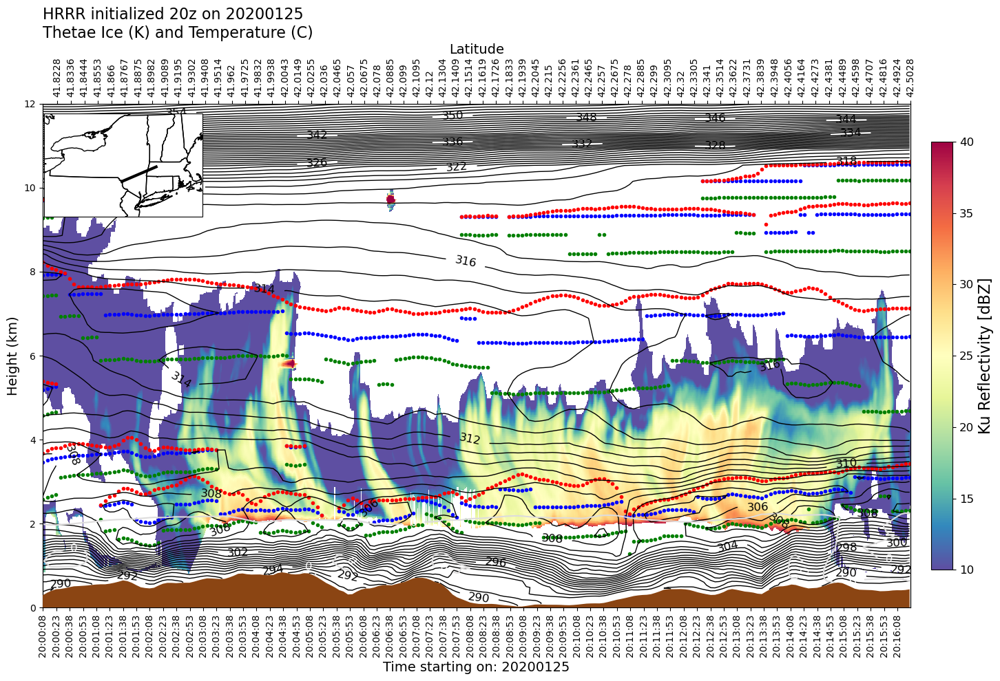

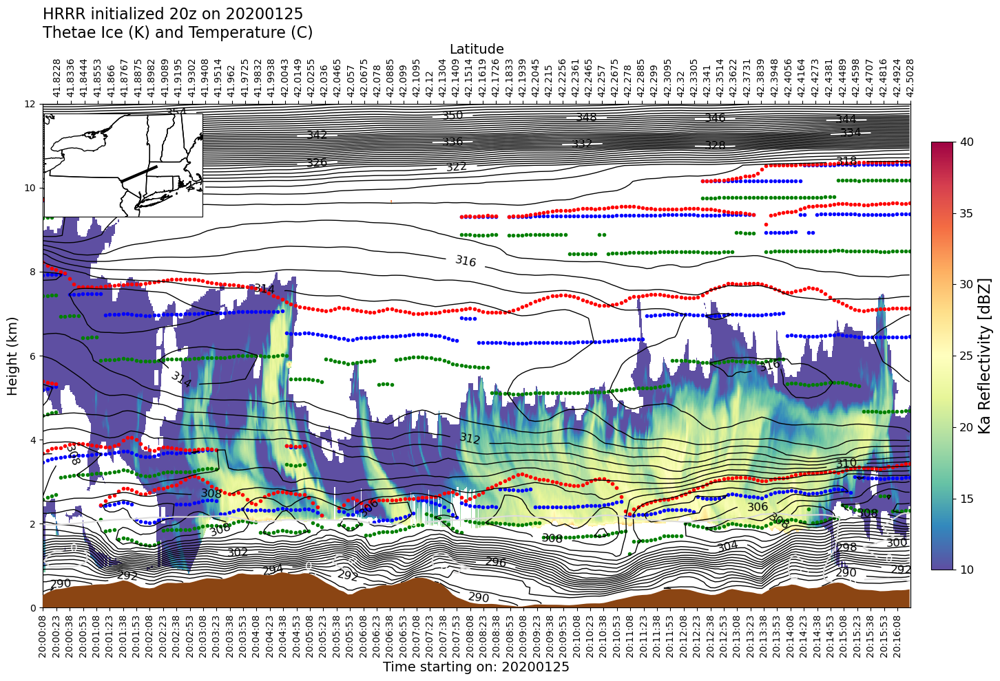

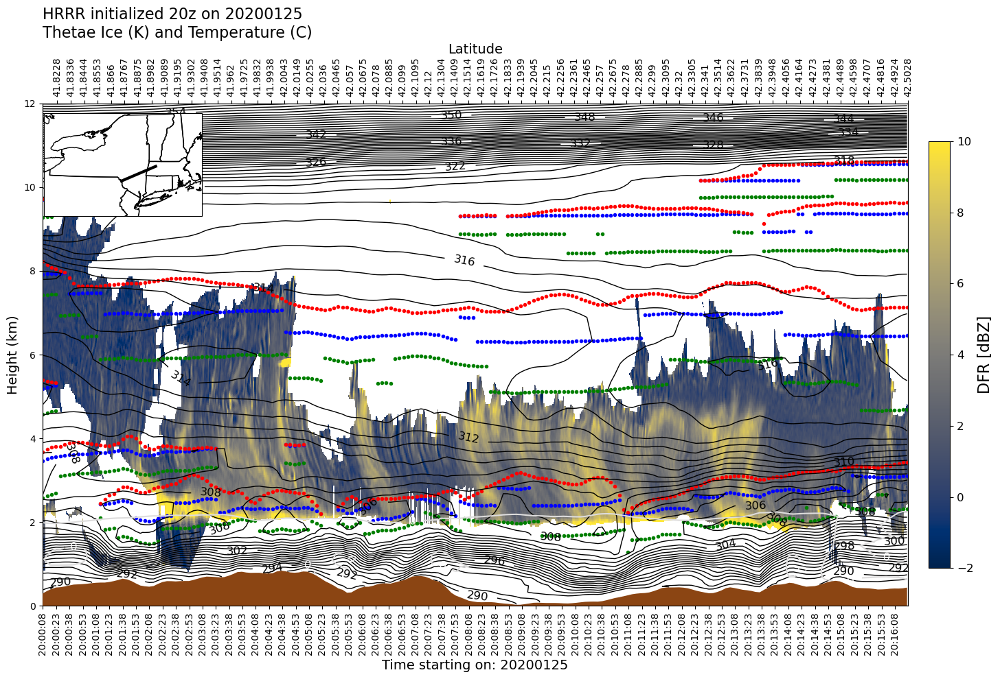

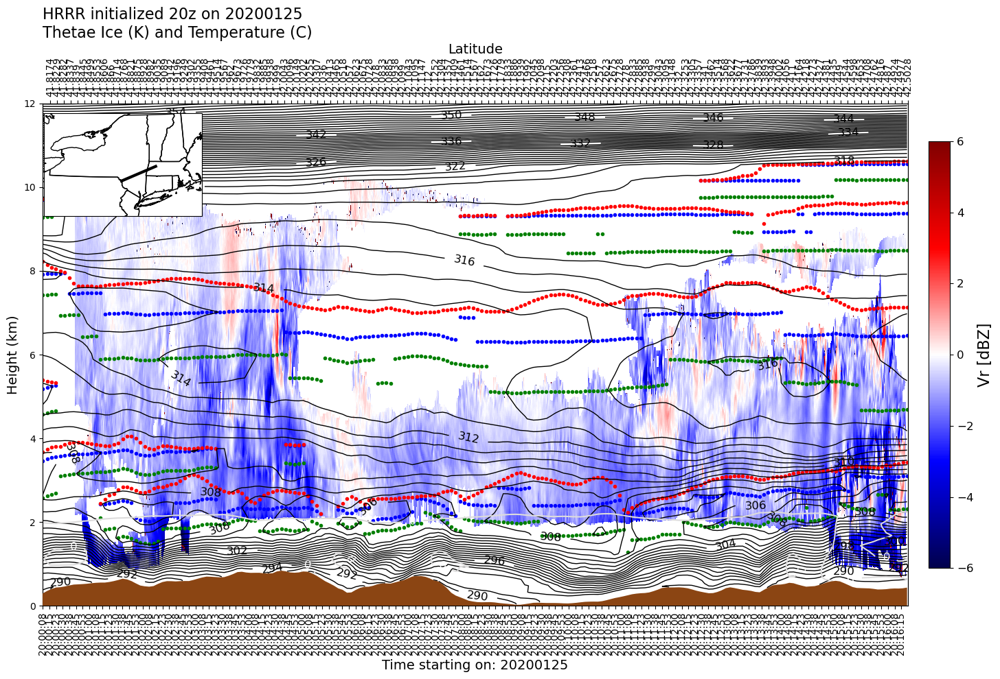

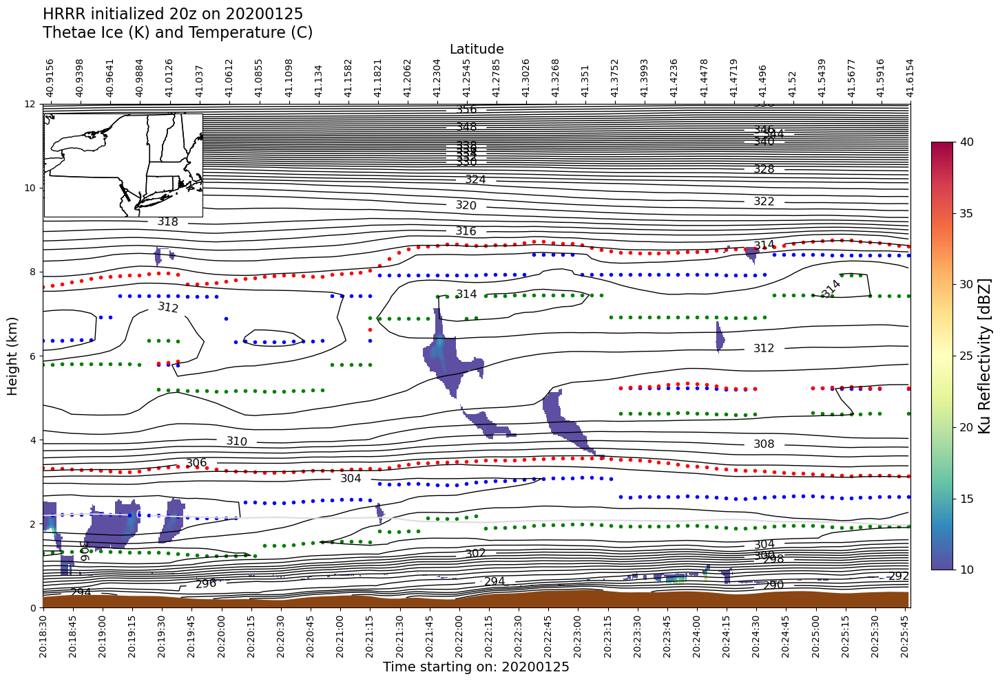

...

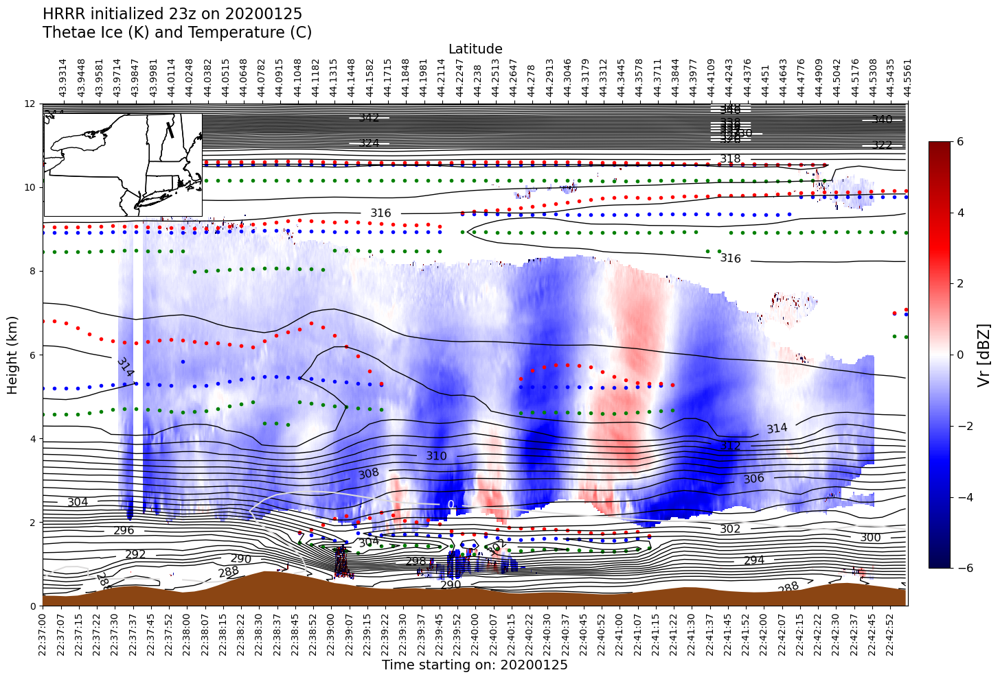

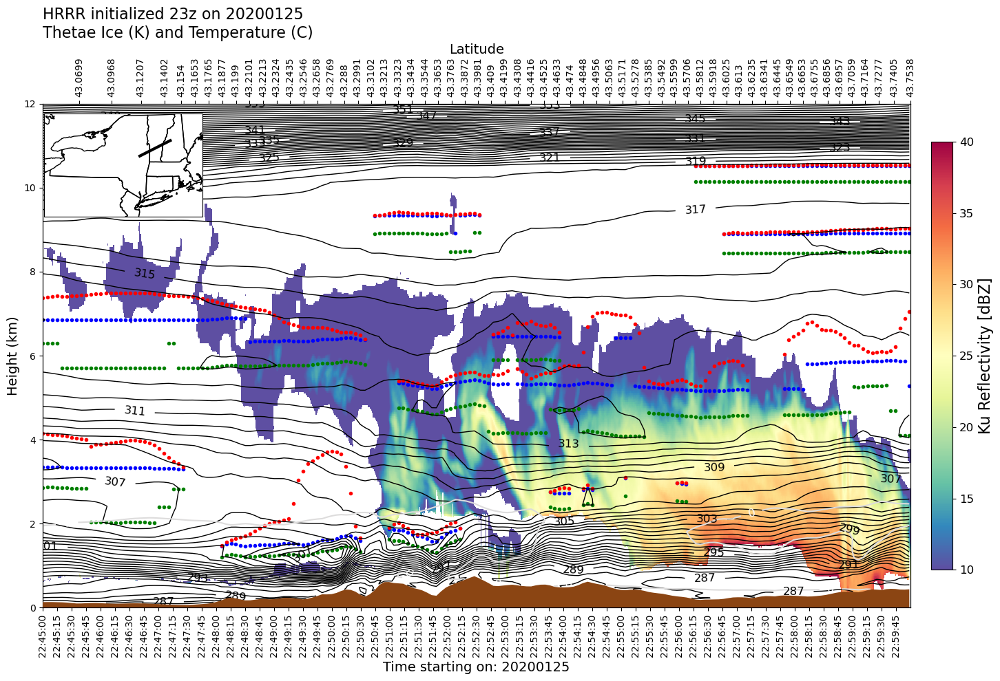

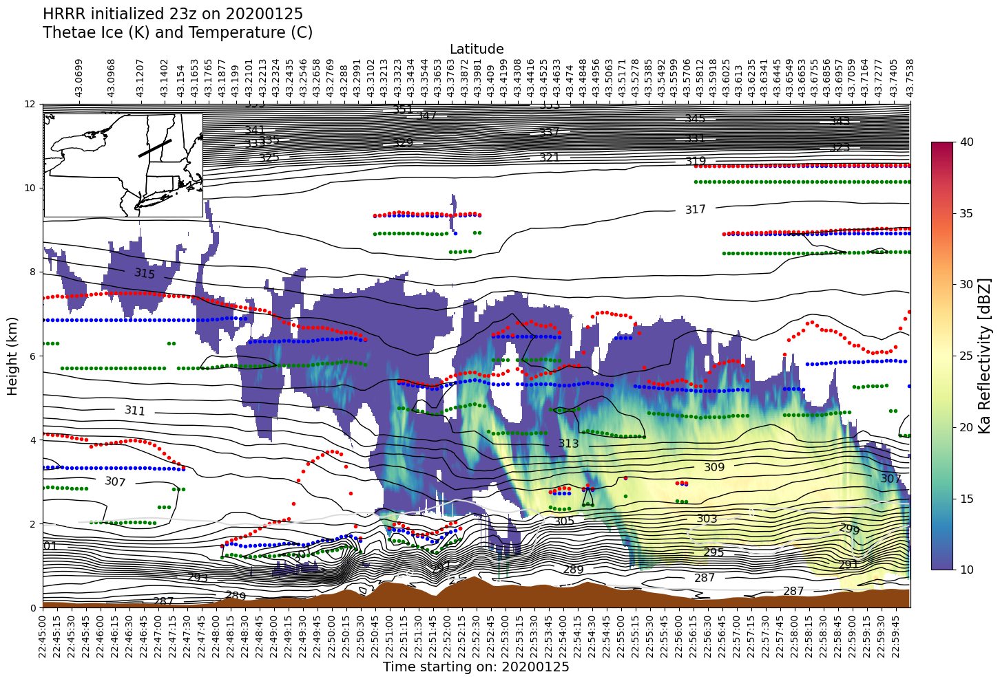

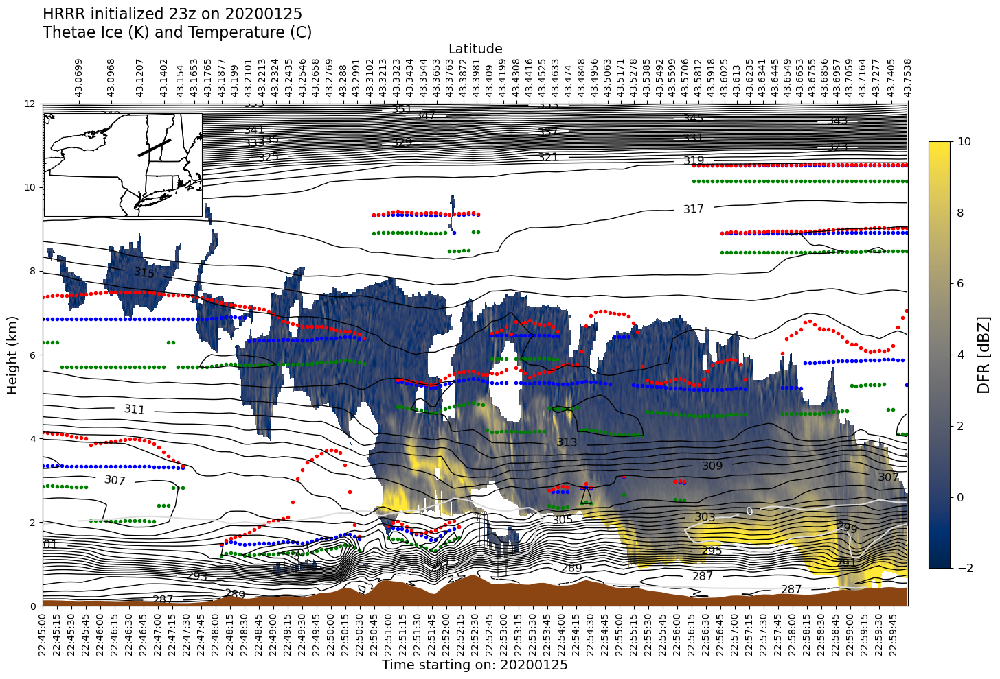

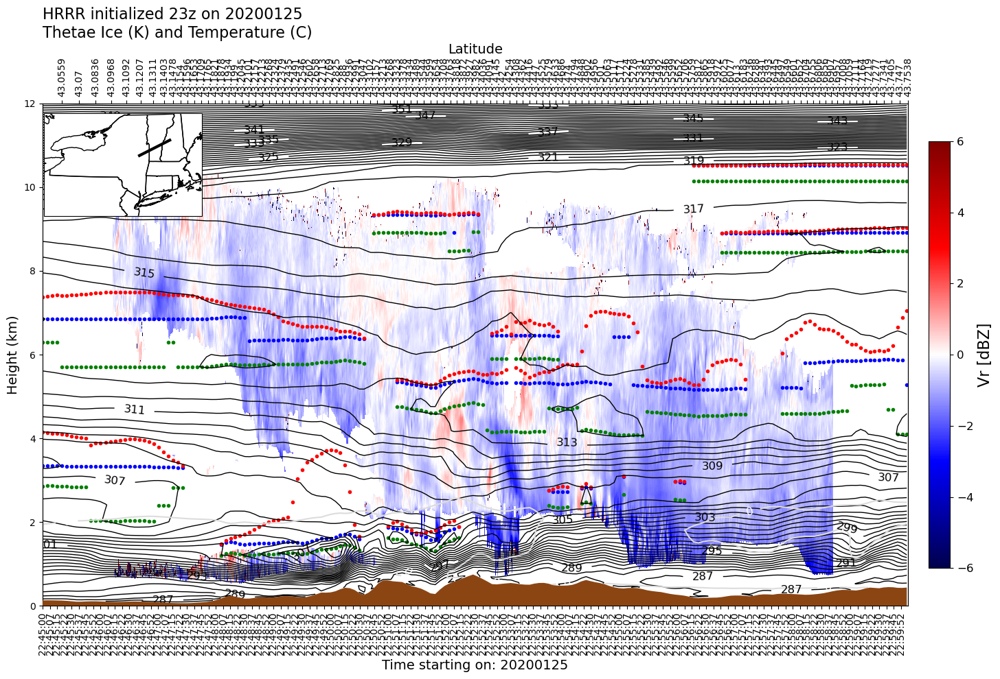

In [47]:
day_EPI_final_ls=[]
day_EPI_p3samp_ls=[]

for n in range(len(hrrr_cs_files_sort)):
    fl=fls[n][2]
    start=fls[n][0]
    end=fls[n][1]
    data=xr.open_dataset(hrrr_cs_files_sort[n])

    # Get the initialization and valid times from the dataset
    init = pd.to_datetime(data.time.values)
    vtime = pd.to_datetime(data.valid_time.values)
    lead = (data.step / np.timedelta64(1, 'h')).astype(int).values

    print(fl, hrrr_cs_files_sort[n])

    # Radar Data
    if yr==2020:
        hiwrap = er2read_gen(hifile_ka)#, ldr_ml=-23)
    if yr!=2020:
        hiwrap = hiwrap_22_23(hifile_ka,hifile_ku)#, ldr_ml=-23)
    if yr!=2023:
        crs = er2read_gen(wfile, vel_sigma=1, max_roll=2)
        crs['vel_W'] = despeckle(crs['vel_W'], sigma=1.)
        crs_sti=np.where(crs['time']==np.datetime64(start))[0][0]
        crs_edi=np.where(crs['time']==np.datetime64(end))[0][0]
        
    hiwrap['dbz_Ku'] = despeckle(hiwrap['dbz_Ku'], sigma=1.)
    hiwrap['dbz_Ka'] = despeckle(hiwrap['dbz_Ka'], sigma=1.)
    hiwrap['vel_Ka'] = despeckle(hiwrap['vel_Ka'], sigma=1)
    hiwrap['vel_Ku'] = despeckle(hiwrap['vel_Ku'], sigma=1)
    hi_sti = np.where(hiwrap['time']==np.datetime64(start))[0][0]
    hi_edi = np.where(hiwrap['time']==np.datetime64(end))[0][0]

    print(start, end)
    print(crs['time'][crs_sti], crs['time'][crs_edi])
    print(hiwrap['time'][hi_sti],hiwrap['time'][hi_edi])

    dfr=melt_lay()

    # cross_sections(data, hiwrap['dbz_Ku'],ft_df.between_time(start[11:], end[11:]), 'HIWRAP', 'Spectral_r', 'Ku Reflectivity', '[dBZ]', vmin=10,vmax=40, thetae=True)
    # cross_sections(data, hiwrap['dbz_Ka'],ft_df.between_time(start[11:], end[11:]), 'HIWRAP', 'Spectral_r', 'Ka Reflectivity', '[dBZ]', vmin=10,vmax=40, thetae=True)
    # cross_sections(data, dfr             ,ft_df.between_time(start[11:], end[11:]), 'HIWRAP', 'cividis'   , 'DFR'            , '[dBZ]', vmin=-2,vmax=10, thetae=True)
    # cross_sections(data, crs["vel_W"]    ,ft_df.between_time(start[11:], end[11:]), 'CRS'   , 'seismic'   , 'Vr'             , '[dBZ]', vmin=-6,vmax=6,  thetae=True)
##########
    raw_df_tog=all_EPI(data, EPI_type)
    EPI_df=EPI_filt(raw_df_tog,EPI_type,EPI_thresh_hgt)

    for k in range(int(EPI_df.columns[-1][-1])):
        gradls=[]
        for j in range(EPI_df.shape[0]):
            dthetae= EPI_df[EPI_type+' Top'+str(k+1)].iloc[j] - EPI_df[EPI_type+' Base'+str(k+1)].iloc[j]
            dz= (EPI_df[EPI_type+' HGT (m) Top'+str(k+1)].iloc[j] - EPI_df[EPI_type+' HGT (m) Base'+str(k+1)].iloc[j])/1000
            gradls.append(dthetae/dz)
        EPI_df['d'+EPI_type+'/dz (K/km) Lay'+str(k+1)]=gradls

    EPI_final=pd.concat([pd.DataFrame(np.ones(EPI_df.shape[0])*float(fl),columns=['FL']),EPI_df, pd.DataFrame(data['latitude'].values,columns=['Lat']), pd.DataFrame(data['longitude'].values, columns=['Lon']),
                    pd.DataFrame(data['orog'].values,columns=['Orog hgt (m)'])],axis=1)
    day_EPI_final_ls.append(EPI_final)

    # hrrr_cs(ft_df.between_time(start[11:], end[11:]), data, data['rh_rhi'], data[EPI_type], 'RH wrt water (T<0) and ice (T>0) [%]', fl_choice+' '+EPI_type+' (K)', cmap="coolwarm", 
    #     levels_cf=np.arange(0,111,1),levels_c=np.arange(np.nanmin(data[EPI_type])-1, np.nanmax(data[EPI_type])+1, 1), EPI=True, EPI_df=raw_df_tog)
    # hrrr_cs(ft_df.between_time(start[11:], end[11:]), data, data['rh_rhi'], data[EPI_type], 'RH wrt water (T<0) and ice (T>0) [%]', fl_choice+' '+EPI_type+' (K)', cmap="coolwarm", 
    #     levels_cf=np.arange(0,111,1),levels_c=np.arange(np.nanmin(data[EPI_type])-1, np.nanmax(data[EPI_type])+1, 1), EPI=True, EPI_df=EPI_final)
###########
    cross_sections(data, hiwrap['dbz_Ku'],ft_df.between_time(start[11:], end[11:]), 'HIWRAP', 'Spectral_r', 'Ku Reflectivity', '[dBZ]', vmin=10,vmax=40, thetae=True, EPI=True, EPI_df=EPI_final)
    cross_sections(data, hiwrap['dbz_Ka'],ft_df.between_time(start[11:], end[11:]), 'HIWRAP', 'Spectral_r', 'Ka Reflectivity', '[dBZ]', vmin=10,vmax=40, thetae=True, EPI=True, EPI_df=EPI_final)
    cross_sections(data, dfr             ,ft_df.between_time(start[11:], end[11:]), 'HIWRAP', 'cividis'   , 'DFR'            , '[dBZ]', vmin=-2,vmax=10, thetae=True, EPI=True, EPI_df=EPI_final)
    cross_sections(data, crs["vel_W"]    ,ft_df.between_time(start[11:], end[11:]), 'CRS'   , 'seismic'   , 'Vr'             , '[dBZ]', vmin=-6,vmax=6,  thetae=True, EPI=True, EPI_df=EPI_final)
###########
    if fl_choice=='P3':
        p3_epi_df=EPI_p3sampled(ft_df.between_time(start[11:], end[11:]), data, EPI_final, EPI_type)
        p3_epi_df_final=pd.concat([pd.DataFrame(np.ones(p3_epi_df.shape[0])*float(fl), columns=['FL'],index=p3_epi_df.index),p3_epi_df], axis=1)
        day_EPI_p3samp_ls.append(p3_epi_df_final)
    
day_EPI_final=pd.concat(day_EPI_final_ls)

if fl_choice=='P3':
    day_EPI_p3samp=pd.concat(day_EPI_p3samp_ls)

In [96]:
day_EPI_final

,FL,thetae Max EPI Layers,thetae Base1,thetae Base2,thetae Base3,thetae Base4,thetae HGT (m) Base1,thetae HGT (m) Base2,thetae HGT (m) Base3,thetae HGT (m) Base4,...,thetae Interp EL (m)3,thetae Interp EL (m)4,dthetae/dz (K/km) Lay1,dthetae/dz (K/km) Lay2,dthetae/dz (K/km) Lay3,dthetae/dz (K/km) Lay4,Lat,Lon,Orog hgt (m),Cat
0,1.0,4.0,309.897570,315.629737,317.735792,318.200532,2321.153032,4690.730585,8487.584572,10172.829389,...,9630.817108,10614.853133,-3.856243,-0.335594,-0.184981,-1.880536,42.502121,-72.852515,434.009929,MB
1,1.0,4.0,309.836571,315.625238,317.731814,318.196542,2307.138504,4681.587610,8485.569724,10172.296828,...,9618.883673,10615.429486,-3.862010,-0.332961,-0.192729,-1.940260,42.498776,-72.863832,417.804741,MB
2,1.0,4.0,309.704253,315.645101,317.740932,318.179276,2301.379009,4677.693460,8484.616980,10171.939927,...,9619.889150,10614.823257,-3.742268,-0.341055,-0.208078,-1.960966,42.495429,-72.875149,411.486772,MB
3,1.0,4.0,309.496647,315.678841,317.759949,318.145663,2302.040220,4677.966939,8484.632640,10171.850453,...,9636.121074,10613.122397,-3.513112,-0.344423,-0.228925,-1.939920,42.492080,-72.886464,412.661088,MB
4,1.0,4.0,309.262493,315.707855,317.770623,318.118393,2297.509208,4674.968510,8484.044942,10171.711887,...,9638.490144,10612.019806,-3.259206,-0.346760,-0.244881,-1.935564,42.488731,-72.897777,407.930356,MB
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,11.0,2.0,308.020730,313.514652,NaN,NaN,2858.849539,5713.519254,NaN,NaN,...,NaN,NaN,-3.680377,-0.193744,NaN,NaN,43.055878,-73.865140,124.797746,MB
180,11.0,2.0,308.064839,313.489928,NaN,NaN,2860.899378,6297.156133,NaN,NaN,...,NaN,NaN,-4.066416,-0.407068,NaN,NaN,43.051889,-73.876144,127.520979,MB
181,11.0,2.0,308.094687,313.469267,NaN,NaN,2863.100887,6297.439121,NaN,NaN,...,NaN,NaN,-4.370609,-0.398774,NaN,NaN,43.047897,-73.887148,130.348878,MB
182,11.0,2.0,308.136568,313.443123,NaN,NaN,2863.631347,6297.086351,NaN,NaN,...,NaN,NaN,-4.587920,-0.388380,NaN,NaN,43.043904,-73.898150,130.948254,MB


# Save EPI layer DataFrame for Entire Day

In [51]:
if EPI_type=='thetaei':
    day_EPI_final.to_csv(path+'PreMLRegime_DataFrames/EPI_ice_Regimes_'+day+'_interpto_'+fl_choice+'.csv')
    if fl_choice=='P3':
        day_EPI_p3samp.to_csv(path+'PreMLRegime_DataFrames/P3EPI_ice_'+day+'_interpto_'+fl_choice+'.csv')
if EPI_type=='thetae':
    day_EPI_final.to_csv(path+'PreMLRegime_DataFrames/EPI_water_Regimes_'+day+'_interpto_'+fl_choice+'.csv')
    if fl_choice=='P3':
        day_EPI_p3samp.to_csv(path+'PreMLRegime_DataFrames/P3EPI_water_'+day+'_interpto_'+fl_choice+'.csv')
    